## Data Loading

Let's start with importing the datasets and creating consistent dataframes of all 3 categories: Human Faces, dogs and cats. We will be using 3000 images from each category to train and test our model.

In [1]:
from google.colab import drive
drive.mount('/content/drive')

# unzipping data files
!unzip -qq "./drive/MyDrive/Dataset/cycleGAN_cats.zip"
!unzip -qq "./drive/MyDrive/Dataset/cycleGAN_faces.zip"
!unzip -qq "./drive/MyDrive/Dataset/cycleGAN_dogs.zip"
!unzip -qq "./face_align_celeba.zip"

# disconnect runtime
# from google.colab import runtime
# runtime.unassign()

# install tensorflow-addons
!pip install tensorflow-addons

Mounted at /content/drive
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 3.8 MB/s eta 0:00:00


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from skimage.transform import resize
import os
import random
import tensorflow_addons as tfa
# import tensorflow_datasets as tfds

# tfds.disable_progress_bar()
autotune = tf.data.AUTOTUNE
random.seed(42)

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [3]:

def create_image_df():
  cat_dir = './cats/cats/'
  dog_dir = './images.cv_93crsmi9z4e6klw0pvbzuv/data/train/animal animal_faces dog dog_face'

  faces_celeb_dir = './img_align_celeba/'
  # faces_cropped_dir = './Datasets/cycleGAN_faces/UTK Face Cropped/utkcropped'

  cat_dir_list = os.listdir(cat_dir)
  dog_dir_list = os.listdir(dog_dir)

  faces_celeb_list = os.listdir(faces_celeb_dir)
  # faces_cropped_list = os.listdir(faces_cropped_dir)


  cat_df = []
  dog_df = []

  faces_celeb_df = []

  i = 0
  for cat_im in cat_dir_list:
    cat_current_im = cv2.imread(os.path.join(cat_dir, cat_im))
    # cat_current_im.reshape(64,64,3)
    cat_current_im = resize(cat_current_im, (128,128,3), mode = "constant",  anti_aliasing=True)
    cat_df.append(cat_current_im)
    i += 1
    if i==3000:
      break
  i = 0
  print("\nCat DF created....")
  for dog_im in dog_dir_list:
    dog_current_im = cv2.imread(os.path.join(dog_dir, dog_im))
    # dog_current_im.reshape(64,64,3)
    dog_current_im = resize(dog_current_im, (128,128,3), mode = "constant",  anti_aliasing=True)
    dog_df.append(dog_current_im)
    i += 1
    if i==3000:
      break
  print("\nDog DF created....")
  i = 0
  for face_celeb_im in faces_celeb_list:
    faces_celeb_current_im = cv2.imread(os.path.join(faces_celeb_dir, face_celeb_im))
    # faces_celeb_current_im.reshape(64,64,3)
    faces_celeb_current_im = resize(faces_celeb_current_im, (128,128,3), mode = "constant",  anti_aliasing=True)
    faces_celeb_df.append(faces_celeb_current_im)
    i += 1
    if i==3000:
      break
  print("\nFace Celeb DF created....")



  return cat_df, dog_df, faces_celeb_df

cat_df, dog_df, faces_celeb_df = create_image_df()





Cat DF created....

Dog DF created....

Face Celeb DF created....


## Data Preprocessing

As part of preprocessing, we will conver the images to numpy arrays and normalize them. We could also use data augmentation techniques to improve the performance of our model, however, we will leave that to future scope of this project.

In [4]:
cat_df = np.asarray(cat_df)
dog_df = np.asarray(dog_df)
faces_celeb_df = np.asarray(faces_celeb_df)

def normalize_img(arr):
    return (arr - arr.min())/(arr.max()-arr.min())

cat_df = normalize_img(cat_df)
dog_df = normalize_img(dog_df)
faces_celeb_df = normalize_img(faces_celeb_df)

In [5]:
## Creating training and test datasets for each domain
cat_df_train = np.asarray(cat_df[:2900])
cat_df_test = np.asarray(cat_df[2900:])

dog_df_train = np.asarray(dog_df[:2900])
dog_df_test = np.asarray(dog_df[2900:])

# faces_comb = faces_celeb_df + faces_cropped_df

# faces_comb_train = np.asarray(faces_comb[:1995])
# faces_comb_test = np.asarray(faces_comb[1995:])
faces_celeb_df_train = np.asarray(faces_celeb_df[:2900])
faces_celeb_df_test = np.asarray(faces_celeb_df[2900:])

It's important to note that we are resizing all images to (128, 128, 3). We experimented with (64, 64, 3) and results were not satisfactory. Images seemed to get distorted very quickly and it was hard to find a balance between loss functions for CycleGAN

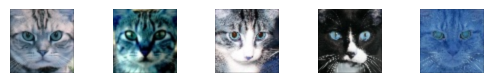

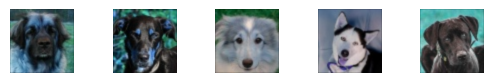

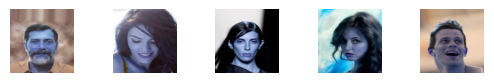

In [ ]:
def display_images(df):
    for i in range(5):
        img_df = df[i]

        # Plot the image
        plt.subplot(5, 5, i + 1)
        plt.imshow(img_df)
        plt.axis('off')

    plt.show()
display_images(cat_df)
display_images(dog_df)
display_images(faces_celeb_df)

Before we move on to the model building phase, we need to modify our image datasets. The keras implementation of CycleGAN expects images to be in the tf.data.Dataset format. We will convert our dataset to the same format and process them.

In [ ]:
# Batch the dataset
batch_size = 16  # Set your desired batch size

# Create a TensorFlow dataset
dataset_cat = tf.data.Dataset.from_tensor_slices(cat_df_train)
dataset_cat = dataset_cat.shuffle(buffer_size=len(cat_df_train))
dataset_cat = dataset_cat.batch(batch_size)
dataset_cat_test = tf.data.Dataset.from_tensor_slices(cat_df_test)


dataset_dog = tf.data.Dataset.from_tensor_slices(dog_df_train)
dataset_dog = dataset_dog.shuffle(buffer_size=len(dog_df_train))
dataset_dog = dataset_dog.batch(batch_size)
dataset_dog_test = tf.data.Dataset.from_tensor_slices(dog_df_test)

dataset_faces = tf.data.Dataset.from_tensor_slices(faces_celeb_df_train)
dataset_faces = dataset_faces.shuffle(buffer_size=len(faces_celeb_df_train))
dataset_faces = dataset_faces.batch(batch_size)
dataset_faces_test = tf.data.Dataset.from_tensor_slices(faces_celeb_df_test)



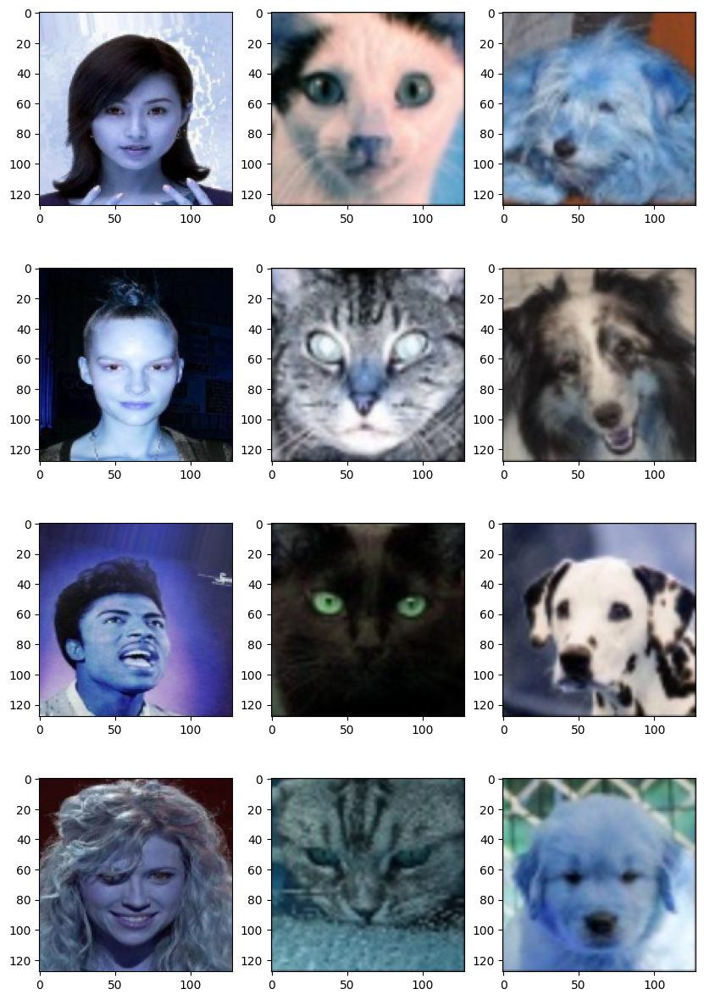

In [ ]:
_, ax = plt.subplots(4, 3, figsize=(10, 15))
for i, samples in enumerate(zip(dataset_faces.take(4), dataset_cat.take(4), dataset_dog.take(4))):

    ax[i, 0].imshow(samples[0][0])
    ax[i, 1].imshow(samples[1][0])
    ax[i, 2].imshow(samples[2][0])
plt.show()

## Building CycleGAN

After preparing the dataset, we move on to the model building phase. We will be using keras implementation of CycleGAN to process the images.

In [6]:
# # Define the standard image size.
# orig_img_size = (64, 64, 3)
input_img_size = (128, 128, 3)
# Weights initializer for the layers.
kernel_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# Gamma initializer for instance normalization.
gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

buffer_size = 256
batch_size = 16

In [7]:
class ReflectionPadding2D(layers.Layer):
    """Implements Reflection Padding as a layer.

    Args:
        padding(tuple): Amount of padding for the
        spatial dimensions.

    Returns:
        A padded tensor with the same type as the input tensor.
    """

    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        super().__init__(**kwargs)

    def call(self, input_tensor, mask=None):
        padding_width, padding_height = self.padding
        padding_tensor = [
            [0, 0],
            [padding_height, padding_height],
            [padding_width, padding_width],
            [0, 0],
        ]
        return tf.pad(input_tensor, padding_tensor, mode="REFLECT")


def residual_block(
    x,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(1, 1),
    padding="valid",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    dim = x.shape[-1]
    input_tensor = x

    x = ReflectionPadding2D()(input_tensor)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = activation(x)

    x = ReflectionPadding2D()(x)
    x = layers.Conv2D(
        dim,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.add([input_tensor, x])
    return x


def downsample(
    x,
    filters,
    activation,
    kernel_initializer=kernel_init,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2D(
        filters,
        kernel_size,
        strides=strides,
        kernel_initializer=kernel_initializer,
        padding=padding,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x


def upsample(
    x,
    filters,
    activation,
    kernel_size=(3, 3),
    strides=(2, 2),
    padding="same",
    kernel_initializer=kernel_init,
    gamma_initializer=gamma_init,
    use_bias=False,
):
    x = layers.Conv2DTranspose(
        filters,
        kernel_size,
        strides=strides,
        padding=padding,
        kernel_initializer=kernel_initializer,
        use_bias=use_bias,
    )(x)
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    if activation:
        x = activation(x)
    return x

The generator consists of downsampling blocks: nine residual blocks and upsampling blocks.

In [8]:
def get_resnet_generator(
    filters=64,
    num_downsampling_blocks=2,
    num_residual_blocks=9,
    num_upsample_blocks=2,
    gamma_initializer=gamma_init,
    name=None,
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = ReflectionPadding2D(padding=(3, 3))(img_input)
    x = layers.Conv2D(filters, (7, 7), kernel_initializer=kernel_init, use_bias=False)(
        x
    )
    x = tfa.layers.InstanceNormalization(gamma_initializer=gamma_initializer)(x)
    x = layers.Activation("relu")(x)

    # Downsampling
    for _ in range(num_downsampling_blocks):
        filters *= 2
        x = downsample(x, filters=filters, activation=layers.Activation("relu"))

    # Residual blocks
    for _ in range(num_residual_blocks):
        x = residual_block(x, activation=layers.Activation("relu"))

    # Upsampling
    for _ in range(num_upsample_blocks):
        filters //= 2
        x = upsample(x, filters, activation=layers.Activation("relu"))

    # Final block
    x = ReflectionPadding2D(padding=(3, 3))(x)
    x = layers.Conv2D(3, (7, 7), padding="valid")(x)
    x = layers.Activation("tanh")(x)

    model = keras.models.Model(img_input, x, name=name)
    return model

The discriminators consists of 4 Convolution layers. The number of filters in each layer are 64,128,256 and 512.

In [9]:
def get_discriminator(
    filters=64, kernel_initializer=kernel_init, num_downsampling=3, name=None
):
    img_input = layers.Input(shape=input_img_size, name=name + "_img_input")
    x = layers.Conv2D(
        filters,
        (4, 4),
        strides=(2, 2),
        padding="same",
        kernel_initializer=kernel_initializer,
    )(img_input)
    x = layers.LeakyReLU(0.2)(x)

    num_filters = filters
    for num_downsample_block in range(3):
        num_filters *= 2
        if num_downsample_block < 2:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(2, 2),
            )
        else:
            x = downsample(
                x,
                filters=num_filters,
                activation=layers.LeakyReLU(0.2),
                kernel_size=(4, 4),
                strides=(1, 1),
            )

    x = layers.Conv2D(
        1, (4, 4), strides=(1, 1), padding="same", kernel_initializer=kernel_initializer
    )(x)

    model = keras.models.Model(inputs=img_input, outputs=x, name=name)
    return model


# Get the generators
gen_G = get_resnet_generator(name="generator_G")
gen_F = get_resnet_generator(name="generator_F")

# Get the discriminators
disc_X = get_discriminator(name="discriminator_X")
disc_Y = get_discriminator(name="discriminator_Y")

/usr/local/lib/python3.10/dist-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


In [10]:
class CycleGan(keras.Model):
    def __init__(
        self,
        generator_G,
        generator_F,
        discriminator_X,
        discriminator_Y,
        lambda_cycle=2.0,
        lambda_identity=1,
    ):
        super().__init__()
        self.gen_G = generator_G
        self.gen_F = generator_F
        self.disc_X = discriminator_X
        self.disc_Y = discriminator_Y
        self.lambda_cycle = lambda_cycle
        self.lambda_identity = lambda_identity

    def compile(
        self,
        gen_G_optimizer,
        gen_F_optimizer,
        disc_X_optimizer,
        disc_Y_optimizer,
        gen_loss_fn,
        disc_loss_fn,
    ):
        super().compile()
        self.gen_G_optimizer = gen_G_optimizer
        self.gen_F_optimizer = gen_F_optimizer
        self.disc_X_optimizer = disc_X_optimizer
        self.disc_Y_optimizer = disc_Y_optimizer
        self.generator_loss_fn = gen_loss_fn
        self.discriminator_loss_fn = disc_loss_fn
        self.cycle_loss_fn = keras.losses.MeanAbsoluteError()
        self.identity_loss_fn = keras.losses.MeanAbsoluteError()

    def train_step(self, batch_data):
        
        real_x, real_y = batch_data

        # For CycleGAN, we need to calculate different
        # kinds of losses for the generators and discriminators.
        # We will perform the following steps here:
        #
        # 1. Pass real images through the generators and get the generated images
        # 2. Pass the generated images back to the generators to check if we
        #    can predict the original image from the generated image.
        # 3. Do an identity mapping of the real images using the generators.
        # 4. Pass the generated images in 1) to the corresponding discriminators.
        # 5. Calculate the generators total loss (adversarial + cycle + identity)
        # 6. Calculate the discriminators loss
        # 7. Update the weights of the generators
        # 8. Update the weights of the discriminators
        # 9. Return the losses in a dictionary

        with tf.GradientTape(persistent=True) as tape:
            # A to fake B
            fake_y = self.gen_G(real_x, training=True)
            # B to fake A -> y2x
            fake_x = self.gen_F(real_y, training=True)

            # Cycle : x -> y -> x
            cycled_x = self.gen_F(fake_y, training=True)
            # Cycle  y -> x -> y
            cycled_y = self.gen_G(fake_x, training=True)

            # Identity mapping
            same_x = self.gen_F(real_x, training=True)
            same_y = self.gen_G(real_y, training=True)

            # Discriminator output
            disc_real_x = self.disc_X(real_x, training=True)
            disc_fake_x = self.disc_X(fake_x, training=True)

            disc_real_y = self.disc_Y(real_y, training=True)
            disc_fake_y = self.disc_Y(fake_y, training=True)

            # Generator adversarial loss
            gen_G_loss = self.generator_loss_fn(disc_fake_y)
            gen_F_loss = self.generator_loss_fn(disc_fake_x)

            # Generator cycle loss
            cycle_loss_G = self.cycle_loss_fn(real_y, cycled_y) * self.lambda_cycle
            cycle_loss_F = self.cycle_loss_fn(real_x, cycled_x) * self.lambda_cycle

            # Generator identity loss
            id_loss_G = (
                self.identity_loss_fn(real_y, same_y)
                * self.lambda_cycle
                * self.lambda_identity
            )
            id_loss_F = (
                self.identity_loss_fn(real_x, same_x)
                * self.lambda_cycle
                * self.lambda_identity
            )

            # Total generator loss
            total_loss_G = gen_G_loss + cycle_loss_G + id_loss_G
            total_loss_F = gen_F_loss + cycle_loss_F + id_loss_F

            # Discriminator loss
            disc_X_loss = self.discriminator_loss_fn(disc_real_x, disc_fake_x)
            disc_Y_loss = self.discriminator_loss_fn(disc_real_y, disc_fake_y)

        # Get the gradients for the generators
        grads_G = tape.gradient(total_loss_G, self.gen_G.trainable_variables)
        grads_F = tape.gradient(total_loss_F, self.gen_F.trainable_variables)

        # Get the gradients for the discriminators
        disc_X_grads = tape.gradient(disc_X_loss, self.disc_X.trainable_variables)
        disc_Y_grads = tape.gradient(disc_Y_loss, self.disc_Y.trainable_variables)

        # Update the weights of the generators
        self.gen_G_optimizer.apply_gradients(
            zip(grads_G, self.gen_G.trainable_variables)
        )
        self.gen_F_optimizer.apply_gradients(
            zip(grads_F, self.gen_F.trainable_variables)
        )

        # Update the weights of the discriminators
        self.disc_X_optimizer.apply_gradients(
            zip(disc_X_grads, self.disc_X.trainable_variables)
        )
        self.disc_Y_optimizer.apply_gradients(
            zip(disc_Y_grads, self.disc_Y.trainable_variables)
        )

        return {
            "G_loss": total_loss_G,
            "F_loss": total_loss_F,
            "D_X_loss": disc_X_loss,
            "D_Y_loss": disc_Y_loss,
        }

Creating a callback to display images after each epoch to assess the results.

In [11]:
class GANMonitor(keras.callbacks.Callback):
    """A callback to generate and save images after each epoch"""

    def __init__(self, num_img=4):
        self.num_img = num_img

    def on_epoch_end(self, epoch, logs=None):
      _, ax = plt.subplots(4, 2, figsize=(12, 12))
      for i, img in enumerate(dataset_faces.take(self.num_img)):
          prediction = self.model.gen_G(img)[0].numpy()

          ax[i, 0].imshow(img[0])
          ax[i, 1].imshow(prediction)
          ax[i, 0].set_title("Input image")
          ax[i, 1].set_title("Translated image")
          ax[i, 0].axis("off")
          ax[i, 1].axis("off")

      plt.show()
      plt.close()

In [12]:
# Loss function for evaluating adversarial loss
adv_loss_fn = keras.losses.MeanSquaredError()

# Define the loss function for the generators
def generator_loss_fn(fake):
    fake_loss = adv_loss_fn(tf.ones_like(fake), fake)
    return fake_loss


# Define the loss function for the discriminators
def discriminator_loss_fn(real, fake):
    real_loss = adv_loss_fn(tf.ones_like(real), real)
    fake_loss = adv_loss_fn(tf.zeros_like(fake), fake)
    return (real_loss + fake_loss) * 0.5


# Create cycle gan model
cycle_gan_model_cat = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)


In [ ]:
!rm -rf model_checkpoints_Human_cat

Before we create the model and start training, let's first understand the hyperparameter selection for various components of cycleGAN. CycleGAN consists of 2 generators and 2 discriminators. The learning rate will be set to 0.00005 for all and beta_1 value of 0.5. We will use Adam optimizer for this. The lambda for cycle loss is set to 2 and for identity loss is set to 1. These values are selected based on the experiments and evaluation of results.

The official documentation of keras cycleGAN implemented the model on Horses and Zebra dataset, which showed quite good results. However, converting Human faces to cats/dogs is a little different. Our problem requires modification of geometrical features instead of simple colour scheme transfers. CycleGAN is known to perform poorly in case of geometrical features.

## Human Faces to Cats

First, we will train our model on images of Humans and cats. We will train the model with a batch size of 16 and 20 epochs. If we train the model any further than it starts to show signs of overfitting and just super imposes the image of a cat on the human face.

Epoch 1/20
182/182 [==============================] - ETA: 0s - G_loss: 2.2871 - F_loss: 2.3355 - D_X_loss: 0.3815 - D_Y_loss: 0.3818

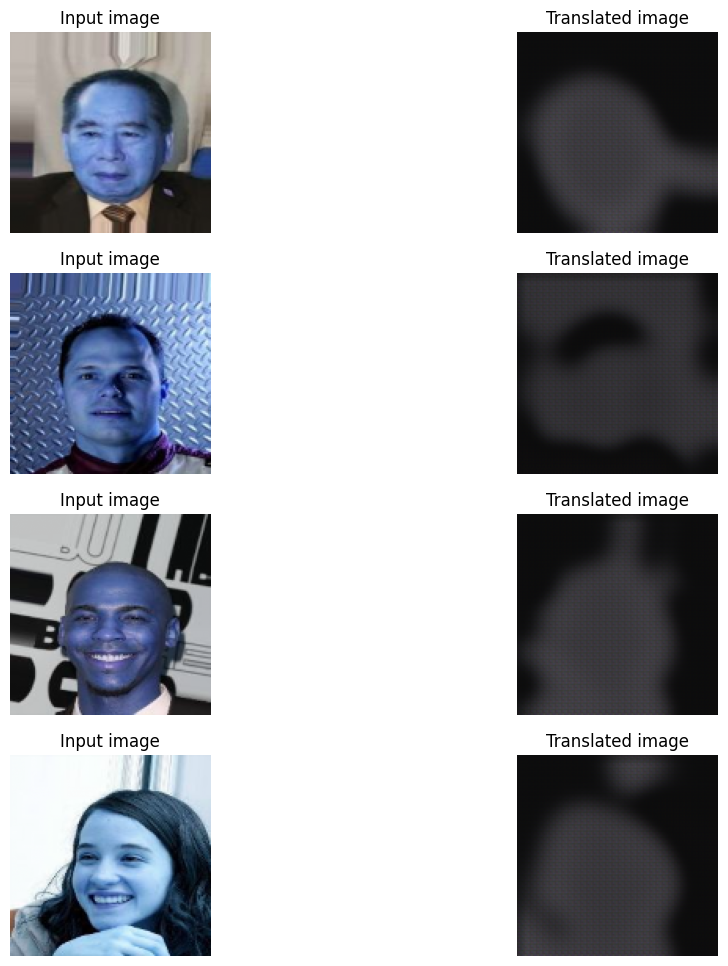

182/182 [==============================] - 113s 319ms/step - G_loss: 2.2827 - F_loss: 2.3322 - D_X_loss: 0.3810 - D_Y_loss: 0.3814
Epoch 2/20
182/182 [==============================] - ETA: 0s - G_loss: 1.1906 - F_loss: 1.5010 - D_X_loss: 0.2253 - D_Y_loss: 0.2708

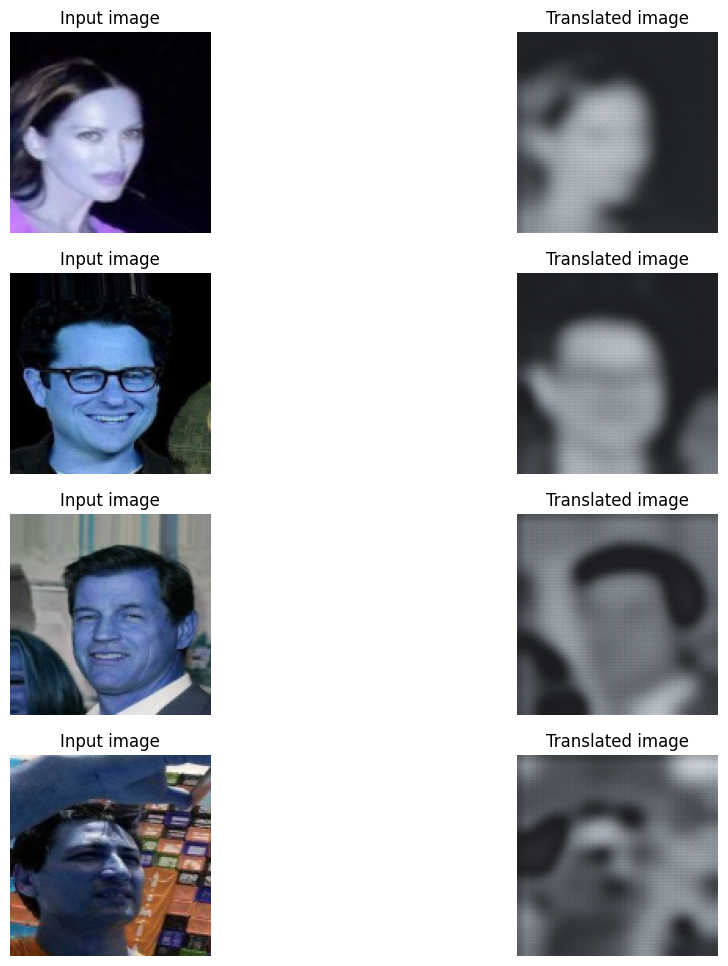

182/182 [==============================] - 58s 319ms/step - G_loss: 1.1886 - F_loss: 1.4993 - D_X_loss: 0.2252 - D_Y_loss: 0.2707
Epoch 3/20
182/182 [==============================] - ETA: 0s - G_loss: 0.8024 - F_loss: 1.0105 - D_X_loss: 0.2017 - D_Y_loss: 0.2492

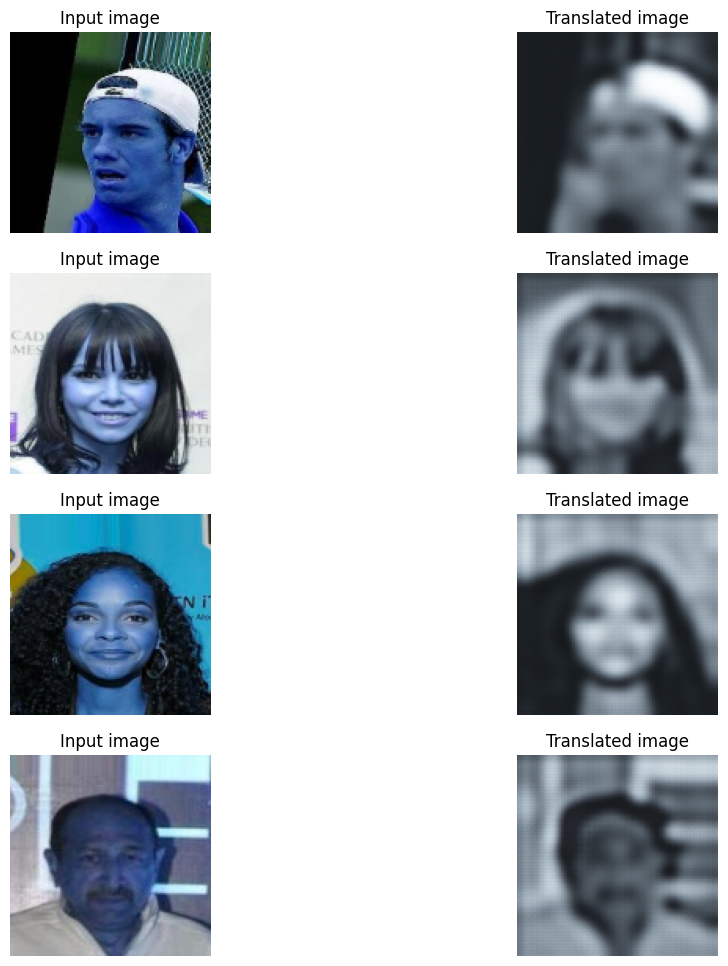

182/182 [==============================] - 58s 319ms/step - G_loss: 0.8014 - F_loss: 1.0103 - D_X_loss: 0.2015 - D_Y_loss: 0.2492
Epoch 4/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7272 - F_loss: 0.8873 - D_X_loss: 0.2052 - D_Y_loss: 0.2444

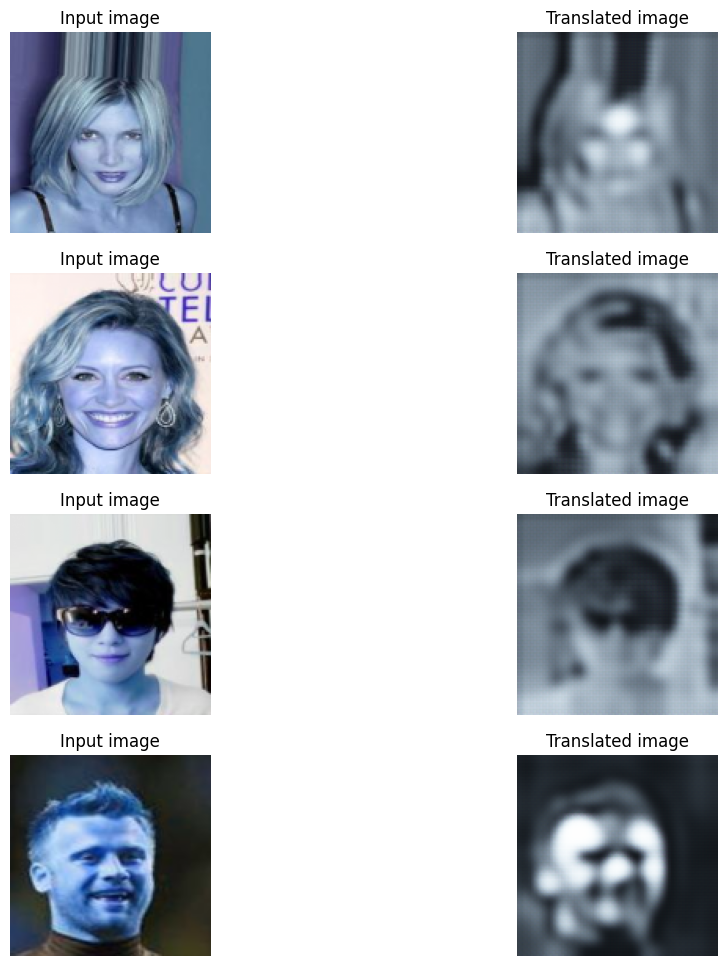

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7277 - F_loss: 0.8875 - D_X_loss: 0.2049 - D_Y_loss: 0.2443
Epoch 5/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7359 - F_loss: 0.9007 - D_X_loss: 0.1755 - D_Y_loss: 0.2310

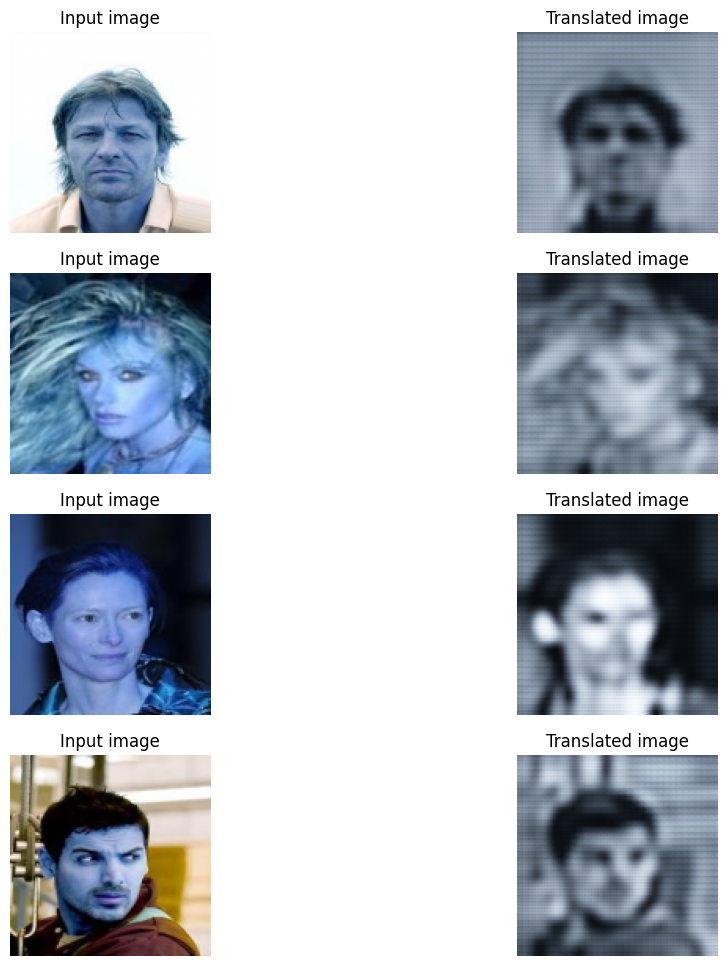

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7358 - F_loss: 0.9015 - D_X_loss: 0.1755 - D_Y_loss: 0.2310
Epoch 6/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7474 - F_loss: 0.8759 - D_X_loss: 0.1886 - D_Y_loss: 0.2232

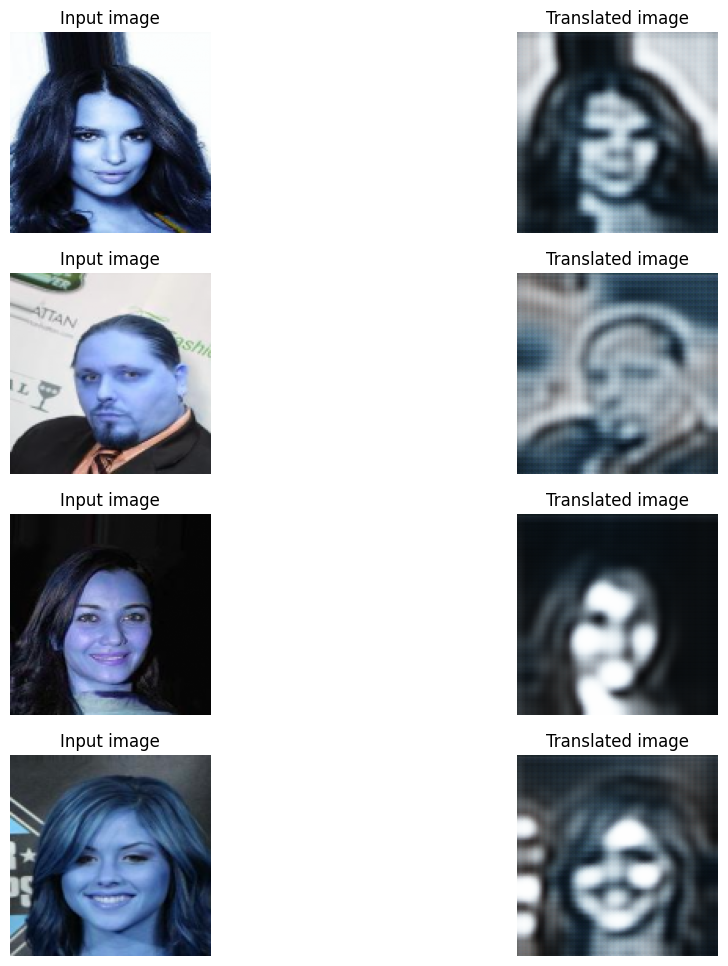

182/182 [==============================] - 58s 320ms/step - G_loss: 0.7487 - F_loss: 0.8757 - D_X_loss: 0.1888 - D_Y_loss: 0.2231
Epoch 7/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7548 - F_loss: 0.8492 - D_X_loss: 0.2035 - D_Y_loss: 0.2080

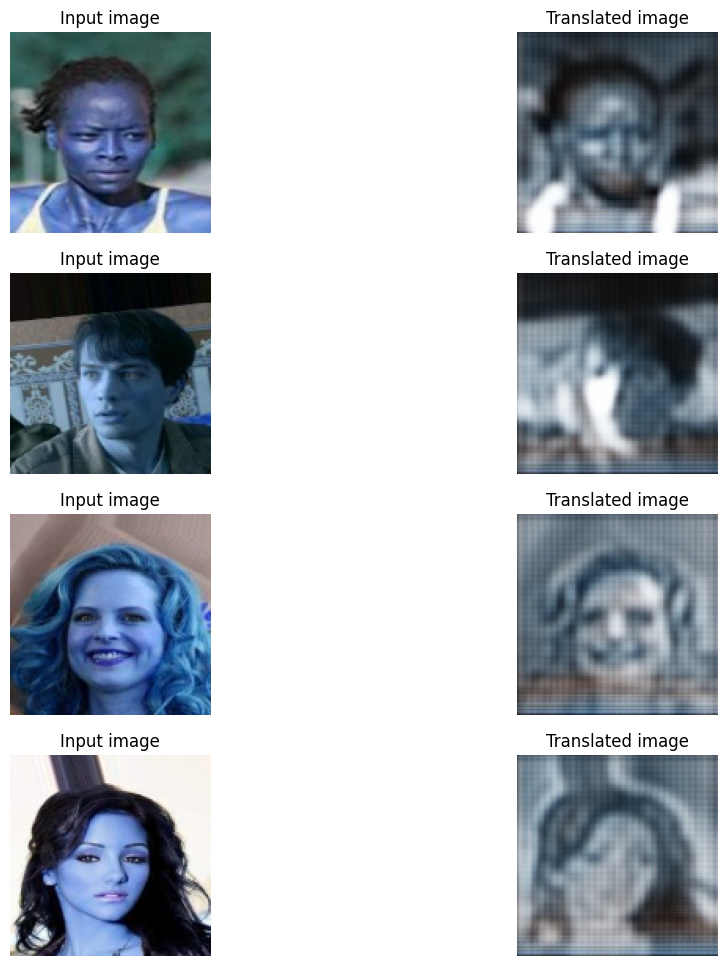

182/182 [==============================] - 59s 324ms/step - G_loss: 0.7546 - F_loss: 0.8489 - D_X_loss: 0.2034 - D_Y_loss: 0.2082
Epoch 8/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7325 - F_loss: 0.8155 - D_X_loss: 0.2184 - D_Y_loss: 0.2260

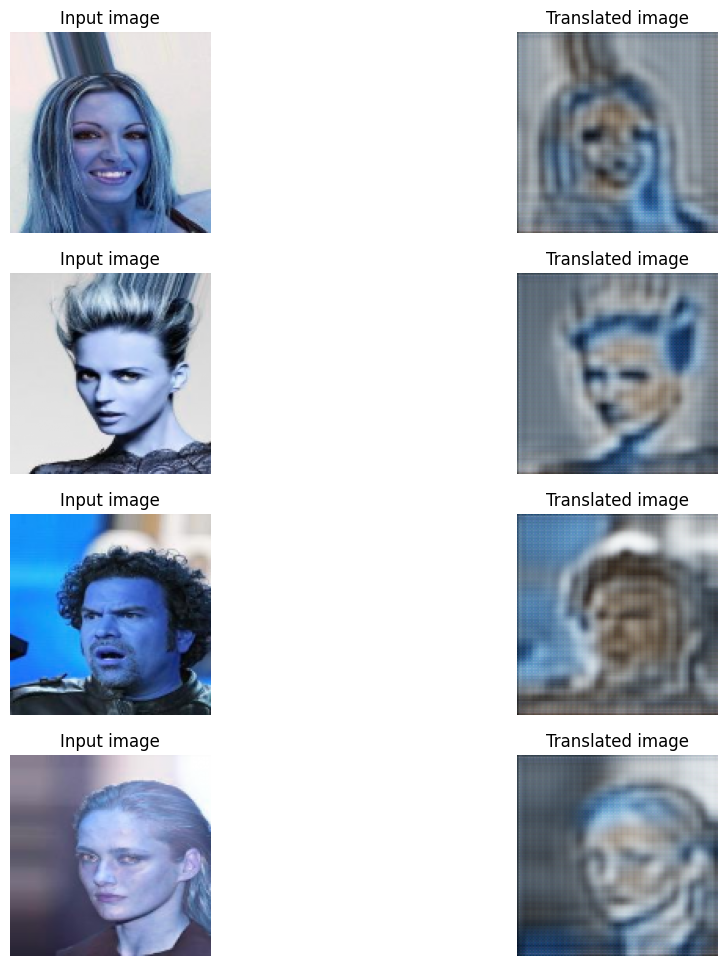

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7332 - F_loss: 0.8153 - D_X_loss: 0.2188 - D_Y_loss: 0.2259
Epoch 9/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7171 - F_loss: 0.7889 - D_X_loss: 0.2217 - D_Y_loss: 0.2211

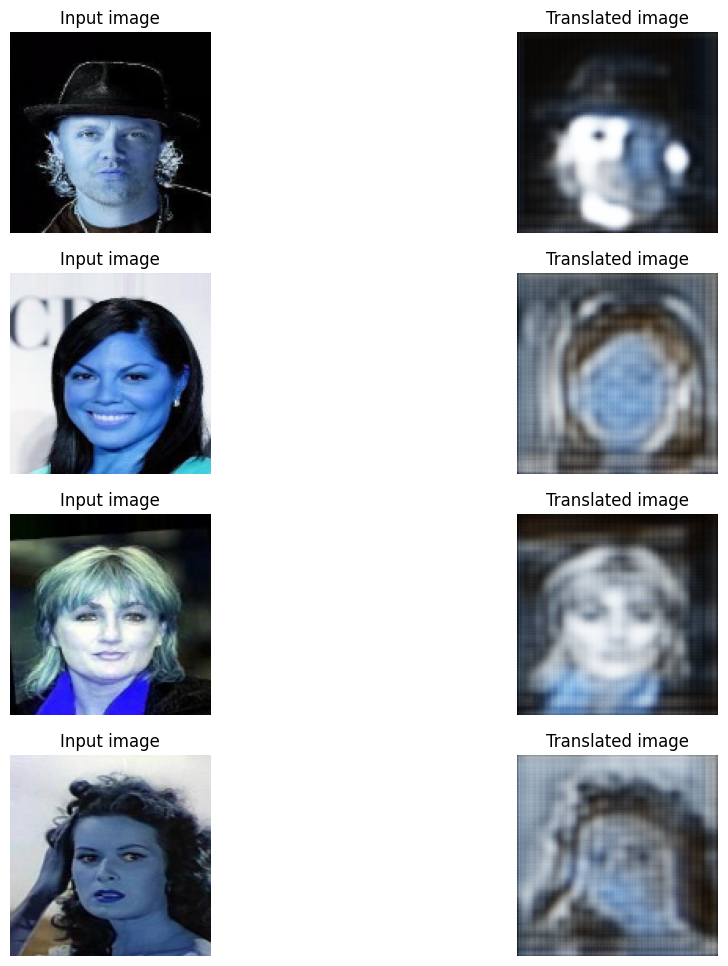

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7167 - F_loss: 0.7892 - D_X_loss: 0.2217 - D_Y_loss: 0.2211
Epoch 10/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7300 - F_loss: 0.7883 - D_X_loss: 0.2278 - D_Y_loss: 0.2187

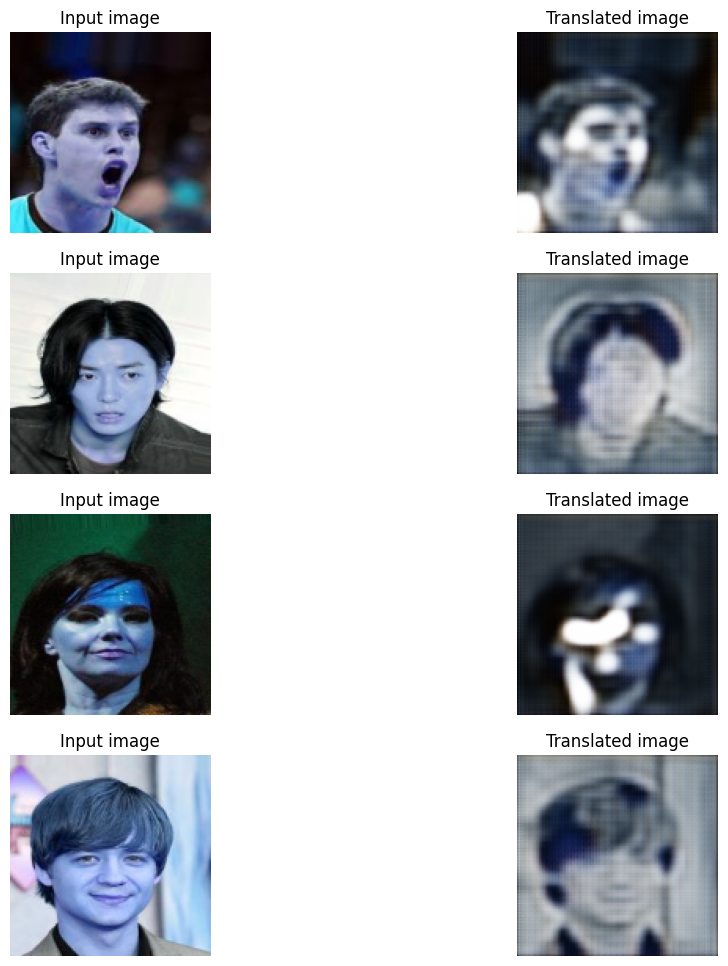

182/182 [==============================] - 58s 320ms/step - G_loss: 0.7297 - F_loss: 0.7882 - D_X_loss: 0.2279 - D_Y_loss: 0.2186
Epoch 11/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7541 - F_loss: 0.7767 - D_X_loss: 0.2236 - D_Y_loss: 0.2068

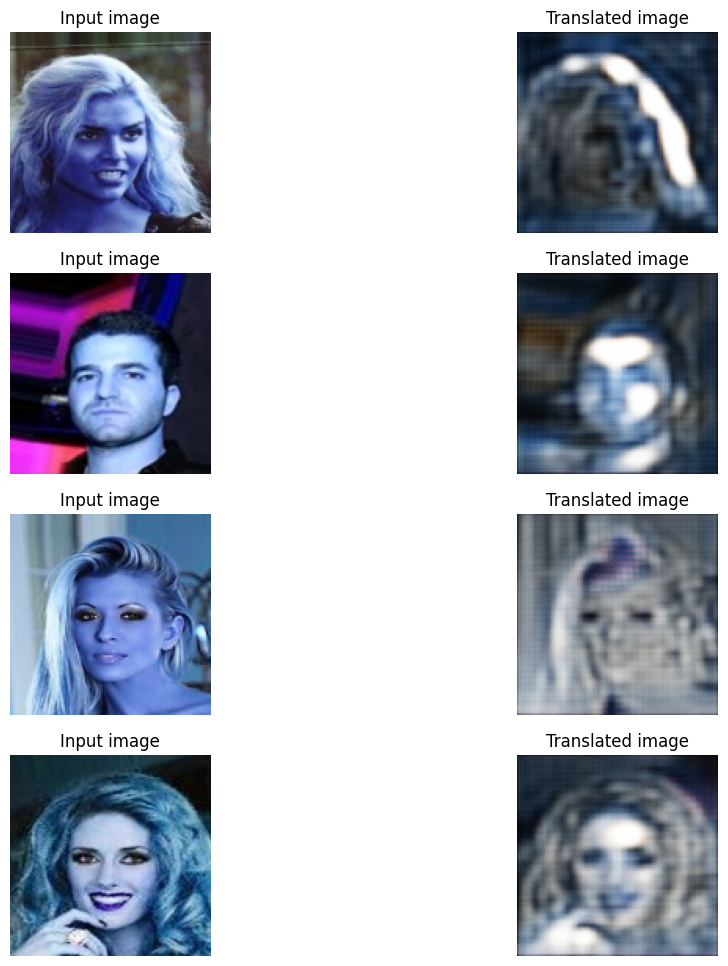

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7536 - F_loss: 0.7771 - D_X_loss: 0.2236 - D_Y_loss: 0.2068
Epoch 12/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7275 - F_loss: 0.7731 - D_X_loss: 0.2268 - D_Y_loss: 0.2185

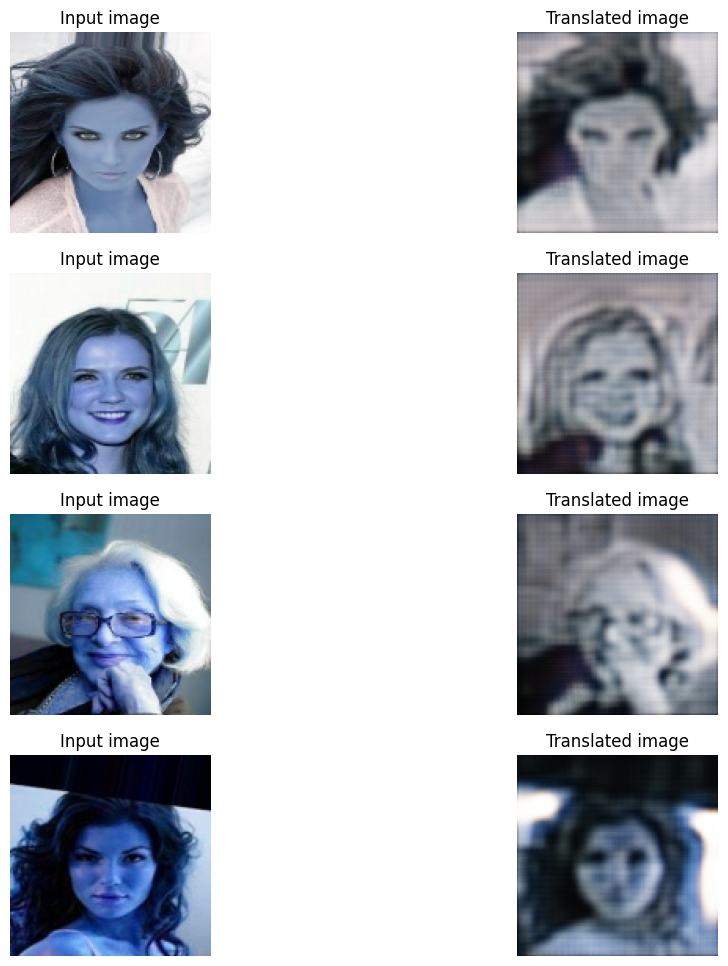

182/182 [==============================] - 58s 320ms/step - G_loss: 0.7268 - F_loss: 0.7729 - D_X_loss: 0.2266 - D_Y_loss: 0.2185
Epoch 13/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7167 - F_loss: 0.7692 - D_X_loss: 0.2294 - D_Y_loss: 0.2256

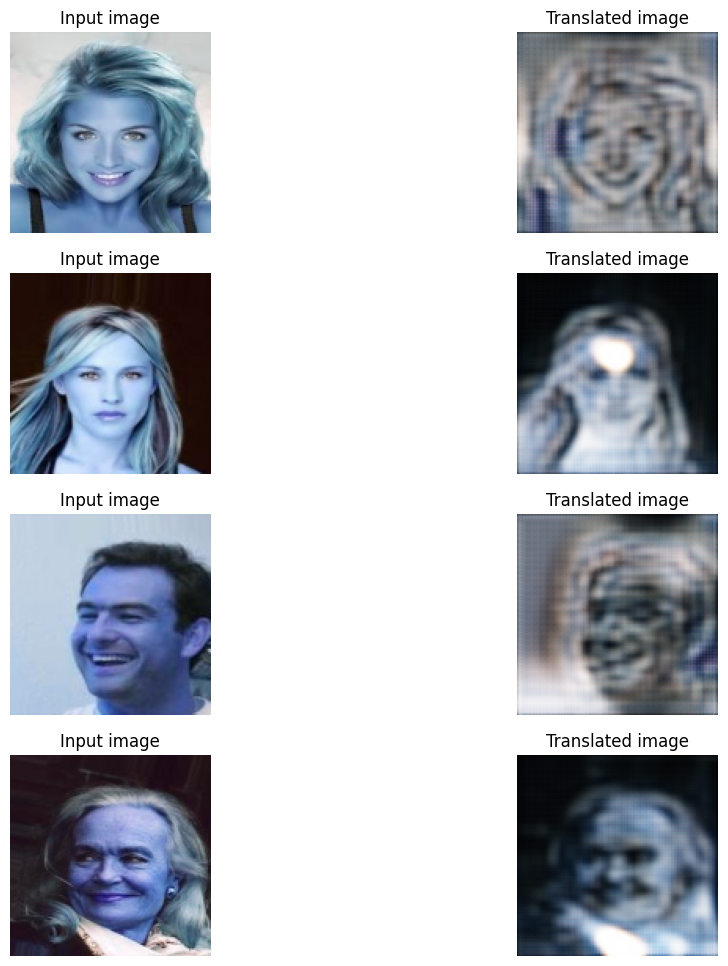

182/182 [==============================] - 58s 320ms/step - G_loss: 0.7170 - F_loss: 0.7694 - D_X_loss: 0.2294 - D_Y_loss: 0.2254
Epoch 14/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7099 - F_loss: 0.7545 - D_X_loss: 0.2293 - D_Y_loss: 0.2249

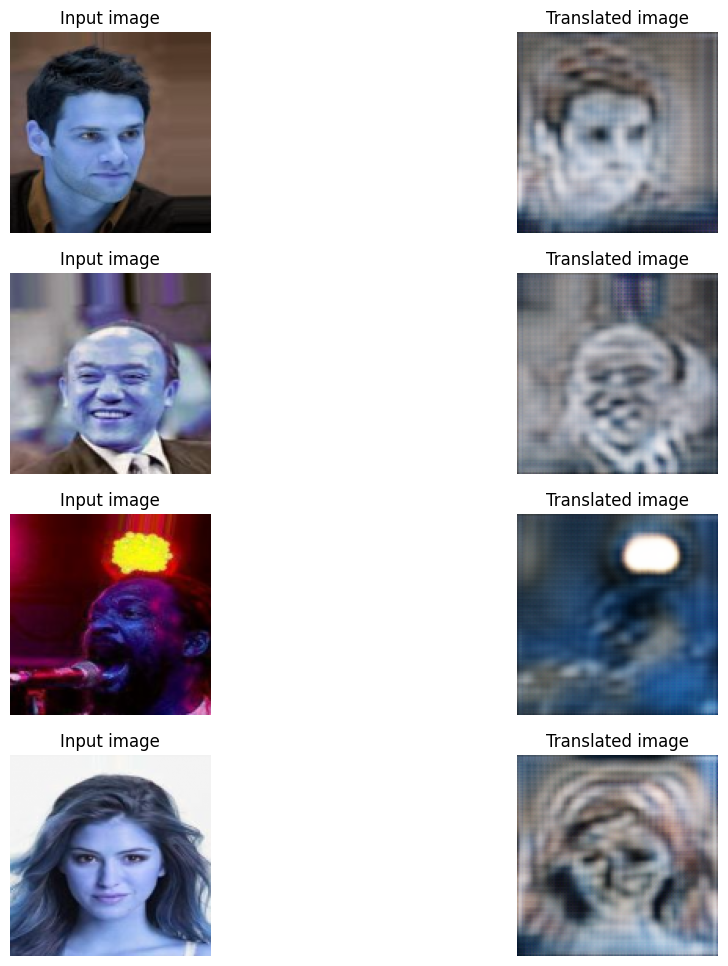

182/182 [==============================] - 58s 320ms/step - G_loss: 0.7107 - F_loss: 0.7544 - D_X_loss: 0.2293 - D_Y_loss: 0.2248
Epoch 15/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7094 - F_loss: 0.7459 - D_X_loss: 0.2262 - D_Y_loss: 0.2236

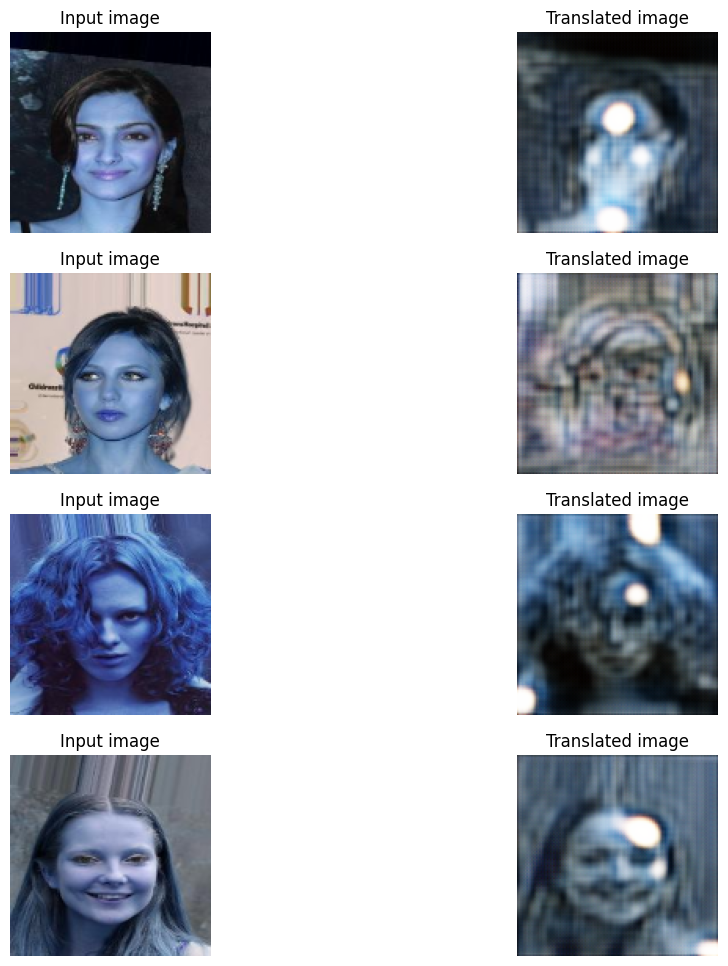

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7089 - F_loss: 0.7456 - D_X_loss: 0.2264 - D_Y_loss: 0.2238
Epoch 16/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7195 - F_loss: 0.7510 - D_X_loss: 0.2274 - D_Y_loss: 0.2216

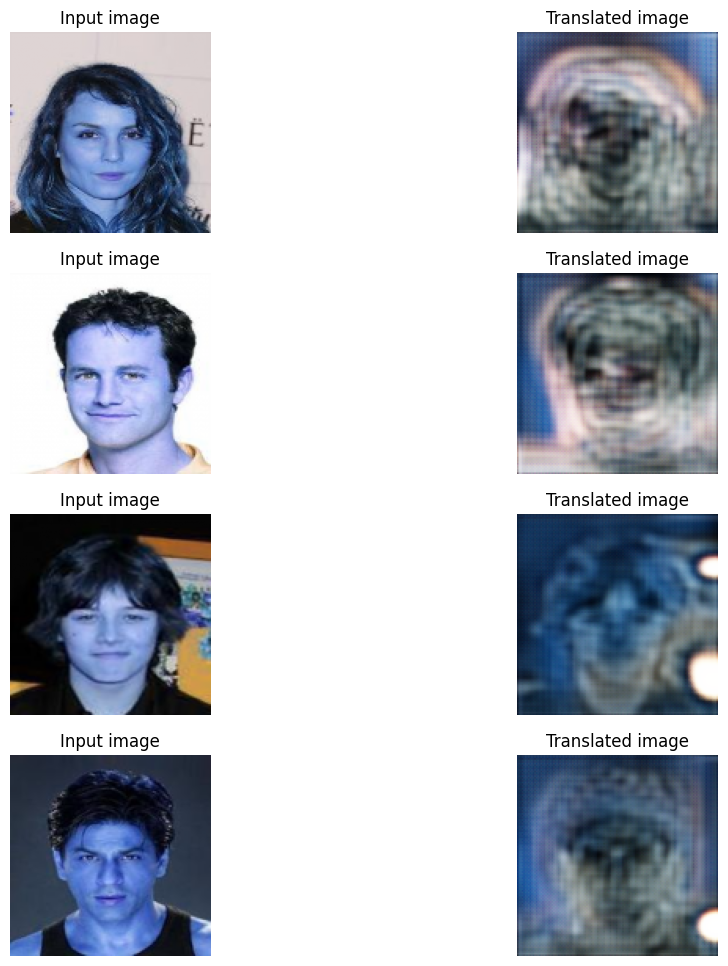

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7191 - F_loss: 0.7521 - D_X_loss: 0.2274 - D_Y_loss: 0.2216
Epoch 17/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7197 - F_loss: 0.7307 - D_X_loss: 0.2275 - D_Y_loss: 0.2206

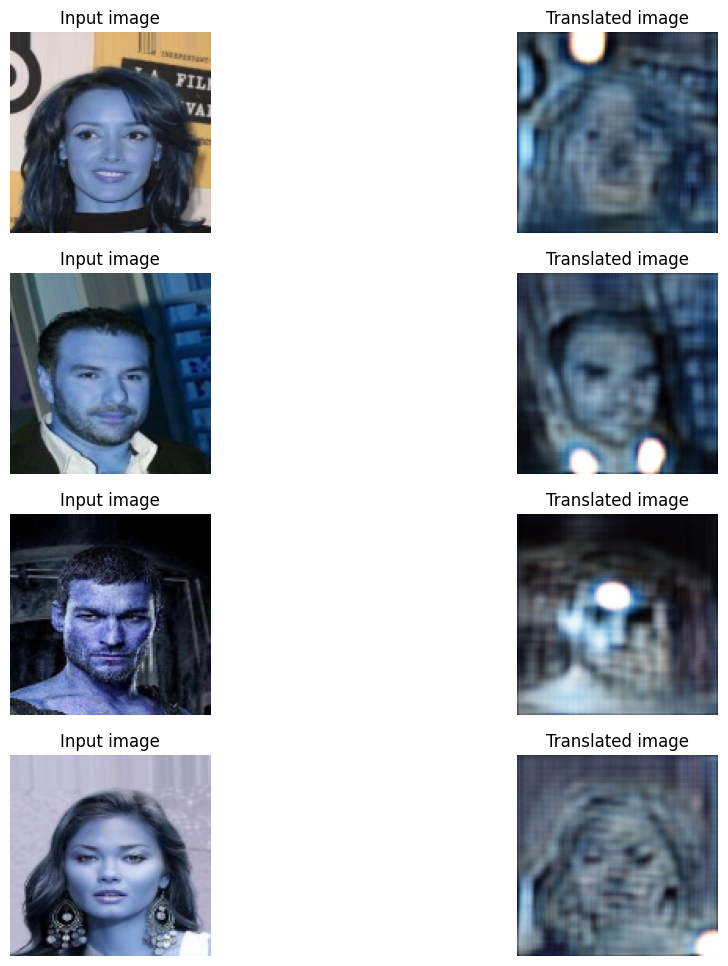

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7195 - F_loss: 0.7303 - D_X_loss: 0.2275 - D_Y_loss: 0.2206
Epoch 18/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7351 - F_loss: 0.7275 - D_X_loss: 0.2285 - D_Y_loss: 0.2167

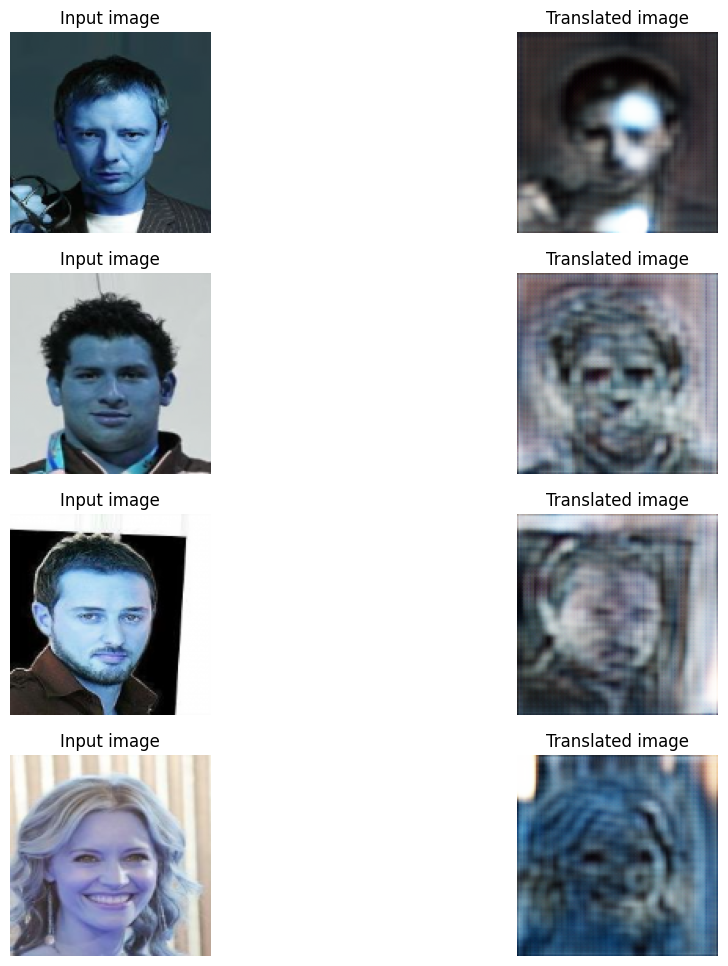

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7355 - F_loss: 0.7277 - D_X_loss: 0.2283 - D_Y_loss: 0.2166
Epoch 19/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7364 - F_loss: 0.7273 - D_X_loss: 0.2301 - D_Y_loss: 0.2189

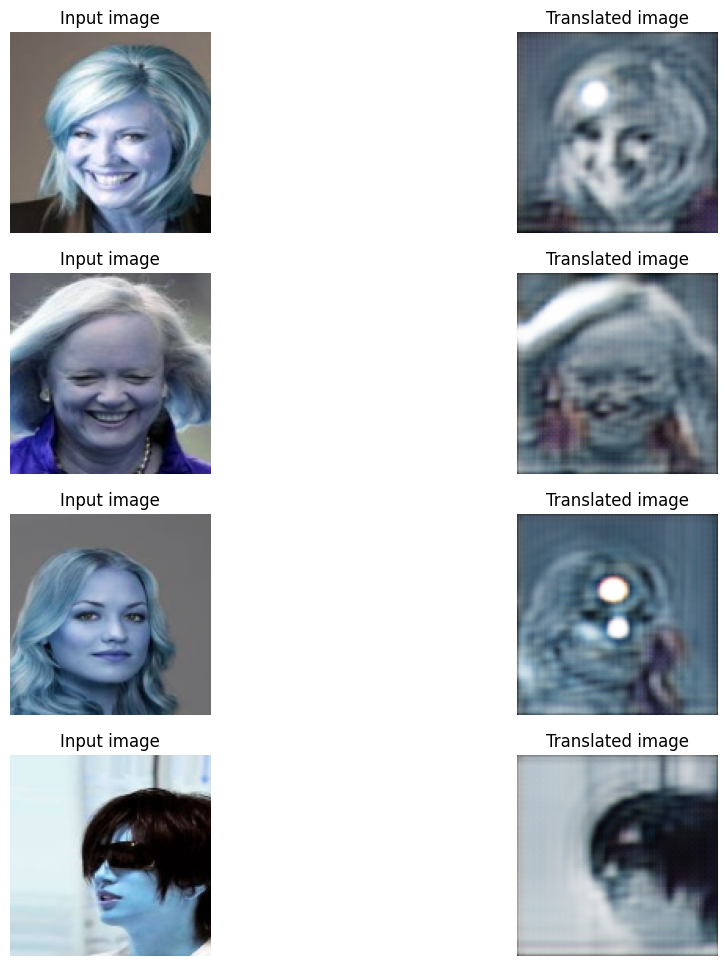

182/182 [==============================] - 59s 325ms/step - G_loss: 0.7363 - F_loss: 0.7274 - D_X_loss: 0.2302 - D_Y_loss: 0.2189
Epoch 20/20
182/182 [==============================] - ETA: 0s - G_loss: 0.7284 - F_loss: 0.7232 - D_X_loss: 0.2276 - D_Y_loss: 0.2234

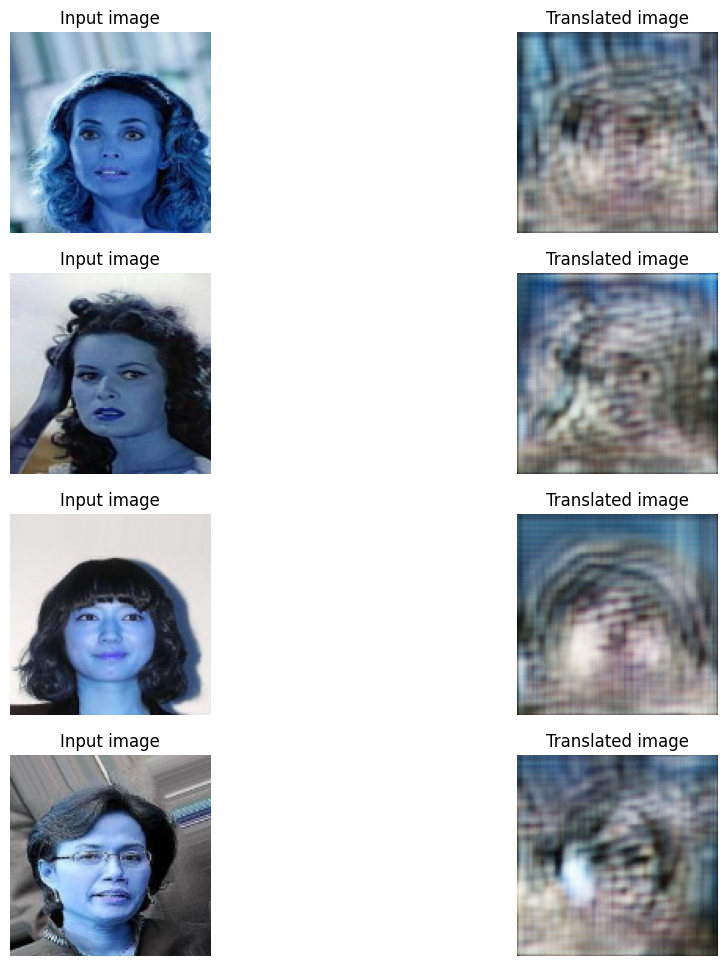

182/182 [==============================] - 58s 320ms/step - G_loss: 0.7285 - F_loss: 0.7228 - D_X_loss: 0.2276 - D_Y_loss: 0.2235


In [ ]:
# Create cycle gan model
cycle_gan_model_cat = CycleGan(
    generator_G=gen_G, generator_F=gen_F, discriminator_X=disc_X, discriminator_Y=disc_Y
)

# Compile the model
cycle_gan_model_cat.compile(
    gen_G_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor()
checkpoint_filepath = "./model_checkpoints_Human_cat/cyclegan_checkpoints.{epoch:03d}"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath, save_weights_only=True
)

# Here we will train the model for just 20 epochs as each epoch takes around
# 4 minutes on a single A100 backed machine.
cycle_gan_model_cat.fit(
    tf.data.Dataset.zip((dataset_faces, dataset_cat)),
    epochs=20,
    callbacks=[plotter, model_checkpoint_callback],
)

The output of 20th epoch has a lot of noise and is not comprehensible. The 17th epoch's output show the best results, with least amount of ripples. We will save this model and use it for evaluating some unknown images.

Weights loaded successfully


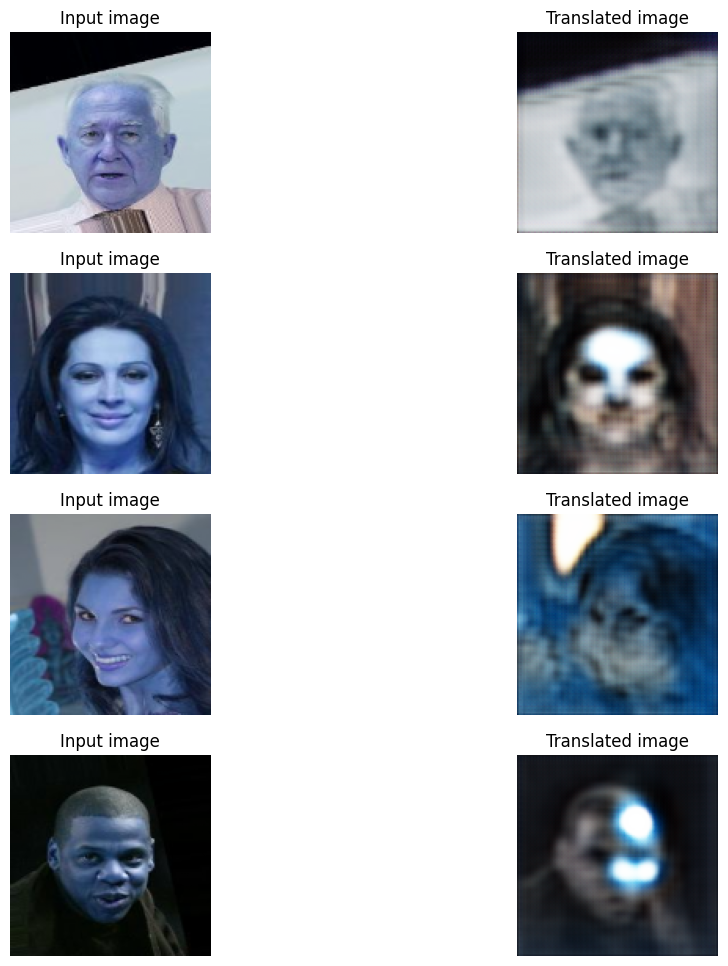

In [ ]:
# # Load the checkpoints
weight_file = "./model_checkpoints_Human_cat/cyclegan_checkpoints.018"
cycle_gan_model_cat.load_weights(weight_file).expect_partial()
print("Weights loaded successfully")



prediction = cycle_gan_model_cat.gen_G(tf.convert_to_tensor(list(dataset_faces_test.as_numpy_iterator()))).numpy()

_, ax = plt.subplots(4, 2, figsize=(12, 12))
for i, img in enumerate(dataset_faces_test.take(4)):

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction[i])
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")
plt.show()
plt.close()


The above results are not the best, however, not the worst either. The second image has cat like features and is starting to look like a cat. There is no significant change in 1st and 4th image.

## Human Faces to Dogs

Now, we will perform the same approach with Human face dataset and Dog dataset.

Epoch 1/25
182/182 [==============================] - ETA: 0s - G_loss: 2.3902 - F_loss: 2.3769 - D_X_loss: 0.3789 - D_Y_loss: 0.3809

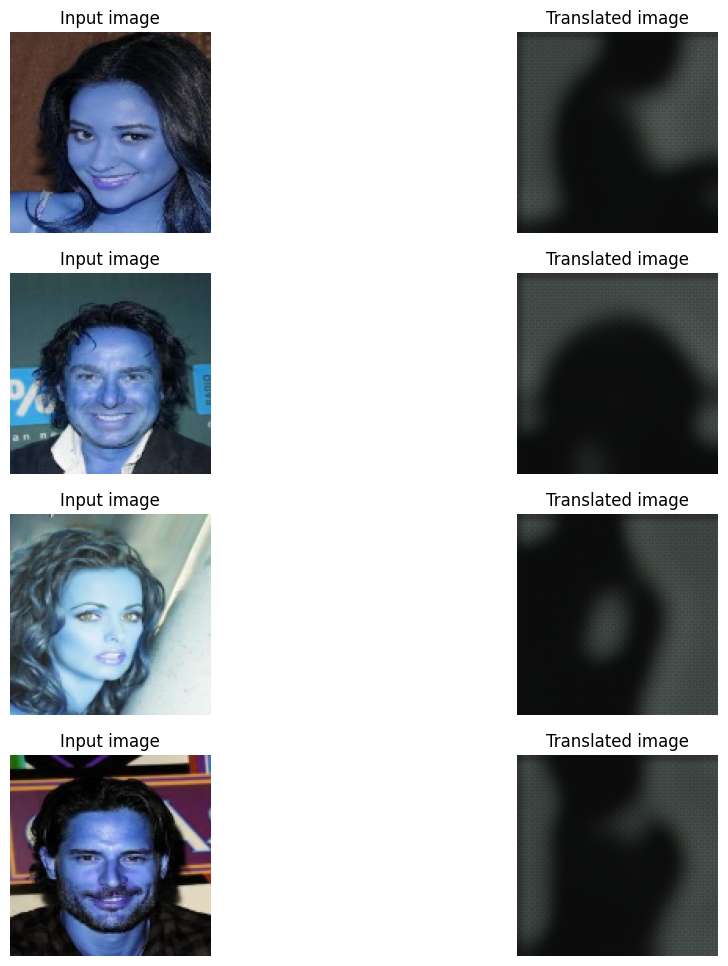

182/182 [==============================] - 113s 319ms/step - G_loss: 2.3855 - F_loss: 2.3734 - D_X_loss: 0.3785 - D_Y_loss: 0.3804
Epoch 2/25
182/182 [==============================] - ETA: 0s - G_loss: 1.3455 - F_loss: 1.5446 - D_X_loss: 0.2033 - D_Y_loss: 0.2211

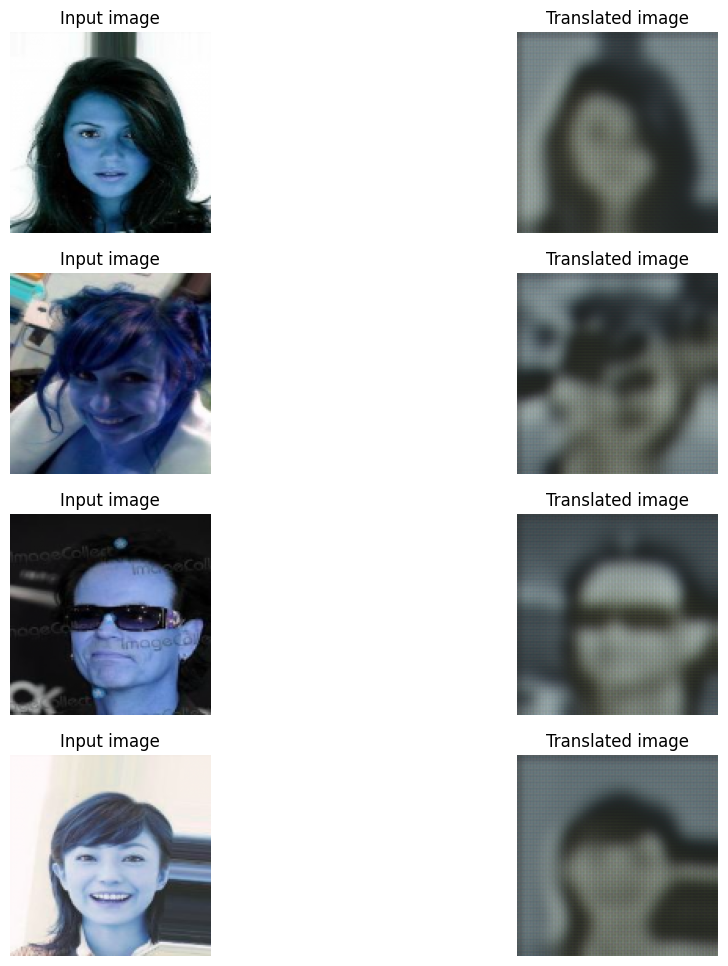

182/182 [==============================] - 58s 319ms/step - G_loss: 1.3446 - F_loss: 1.5432 - D_X_loss: 0.2033 - D_Y_loss: 0.2210
Epoch 3/25
182/182 [==============================] - ETA: 0s - G_loss: 0.8693 - F_loss: 1.0390 - D_X_loss: 0.2158 - D_Y_loss: 0.2246

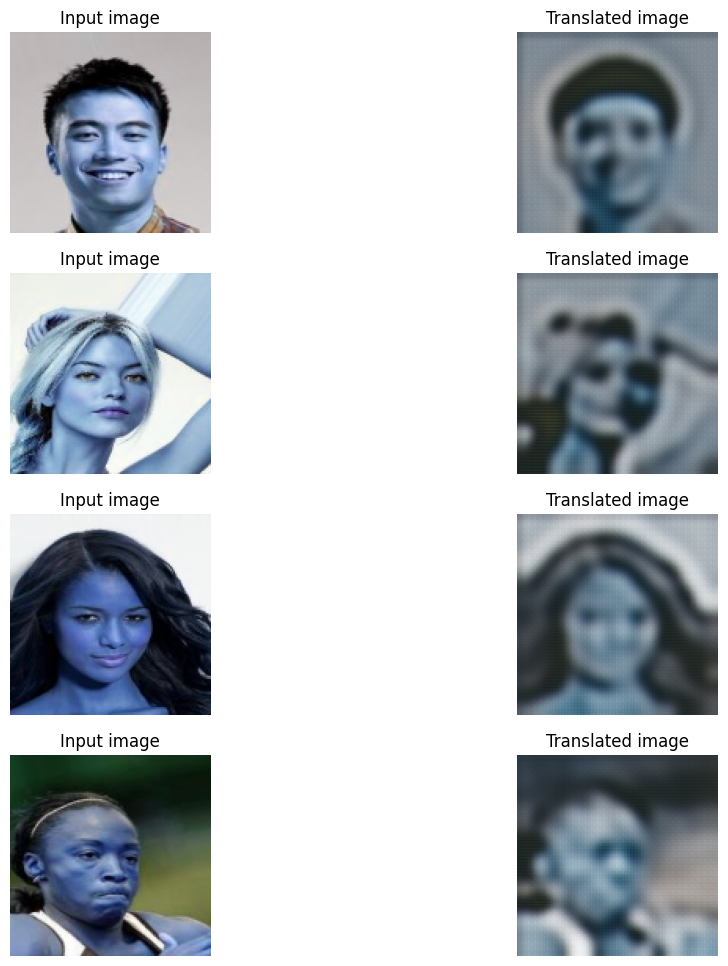

182/182 [==============================] - 58s 320ms/step - G_loss: 0.8695 - F_loss: 1.0383 - D_X_loss: 0.2157 - D_Y_loss: 0.2244
Epoch 4/25
182/182 [==============================] - ETA: 0s - G_loss: 0.7266 - F_loss: 0.8327 - D_X_loss: 0.2182 - D_Y_loss: 0.2386

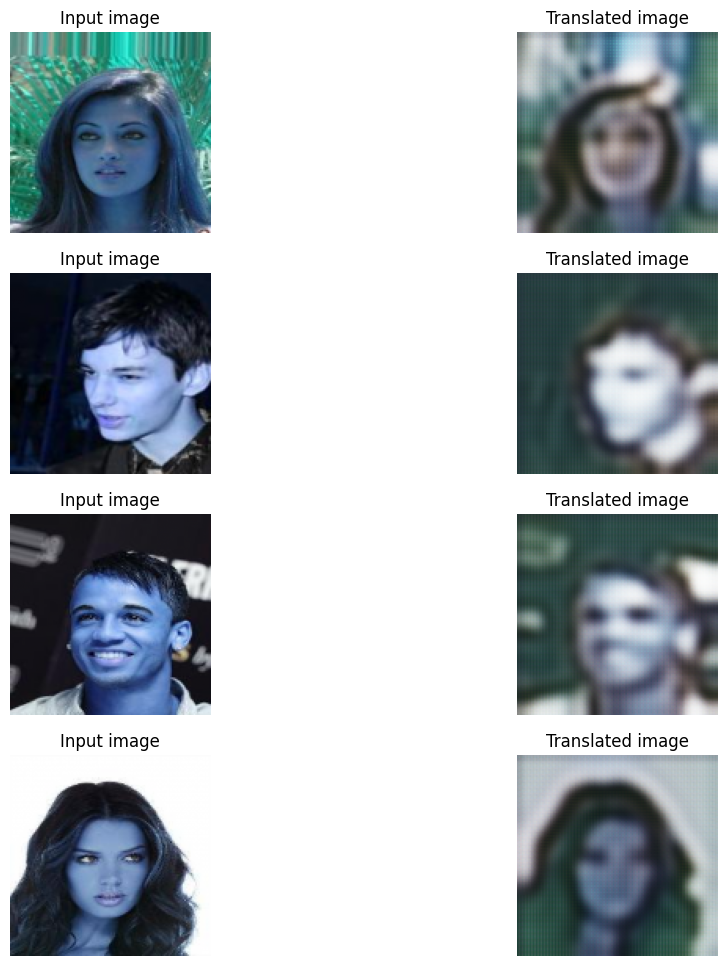

182/182 [==============================] - 58s 320ms/step - G_loss: 0.7260 - F_loss: 0.8320 - D_X_loss: 0.2186 - D_Y_loss: 0.2387
Epoch 5/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6782 - F_loss: 0.7640 - D_X_loss: 0.2438 - D_Y_loss: 0.2365

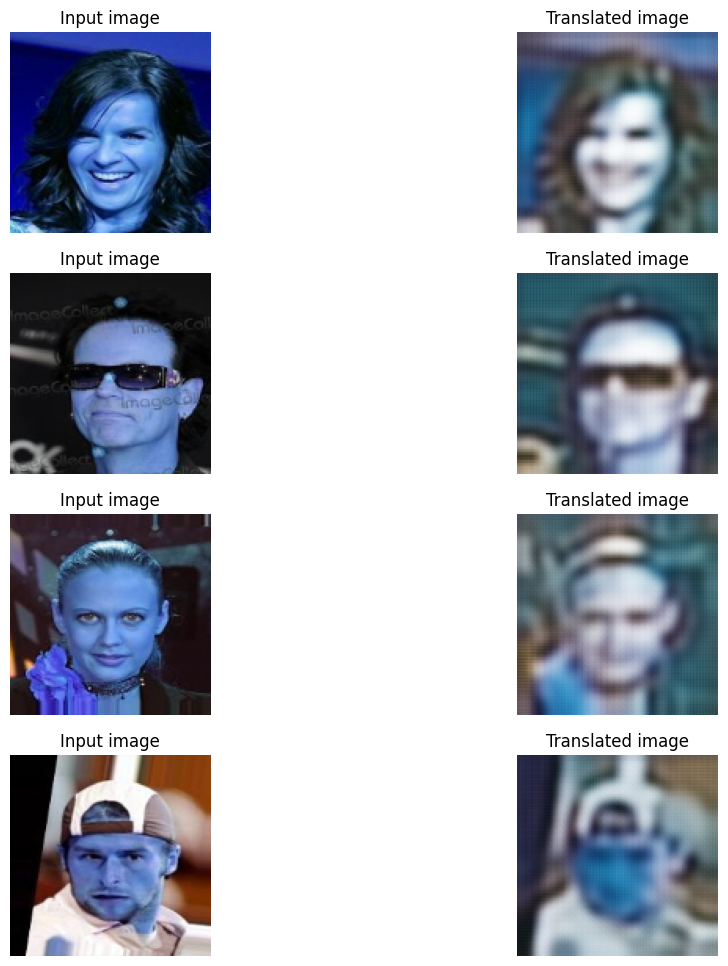

182/182 [==============================] - 58s 321ms/step - G_loss: 0.6785 - F_loss: 0.7636 - D_X_loss: 0.2437 - D_Y_loss: 0.2366
Epoch 6/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6881 - F_loss: 0.7870 - D_X_loss: 0.2012 - D_Y_loss: 0.2131

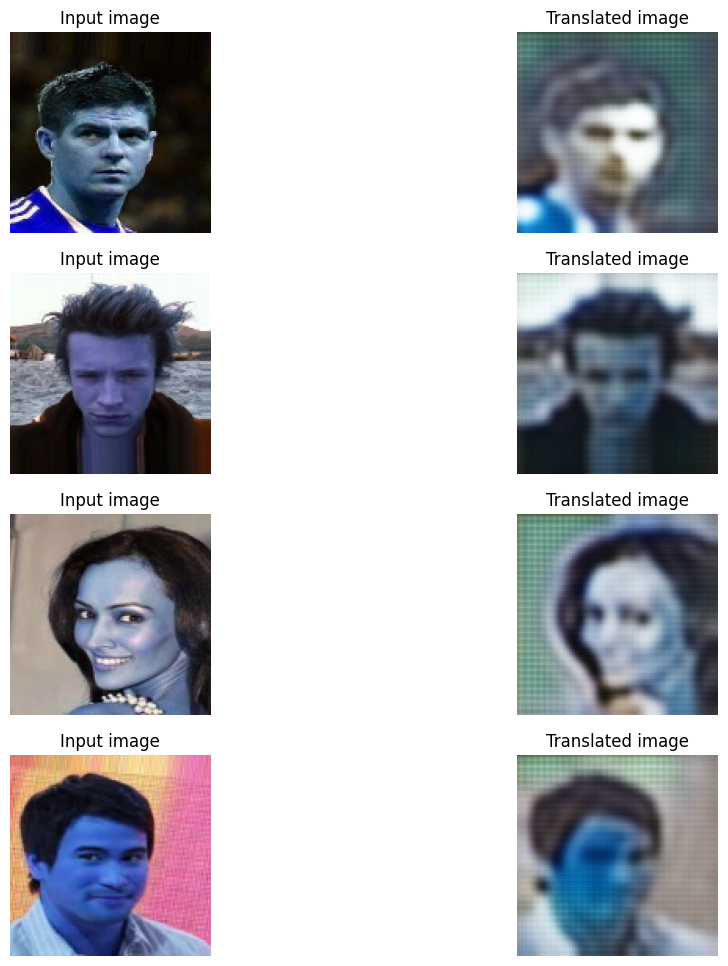

182/182 [==============================] - 58s 320ms/step - G_loss: 0.6885 - F_loss: 0.7868 - D_X_loss: 0.2011 - D_Y_loss: 0.2130
Epoch 7/25
182/182 [==============================] - ETA: 0s - G_loss: 0.7109 - F_loss: 0.8001 - D_X_loss: 0.1919 - D_Y_loss: 0.2088

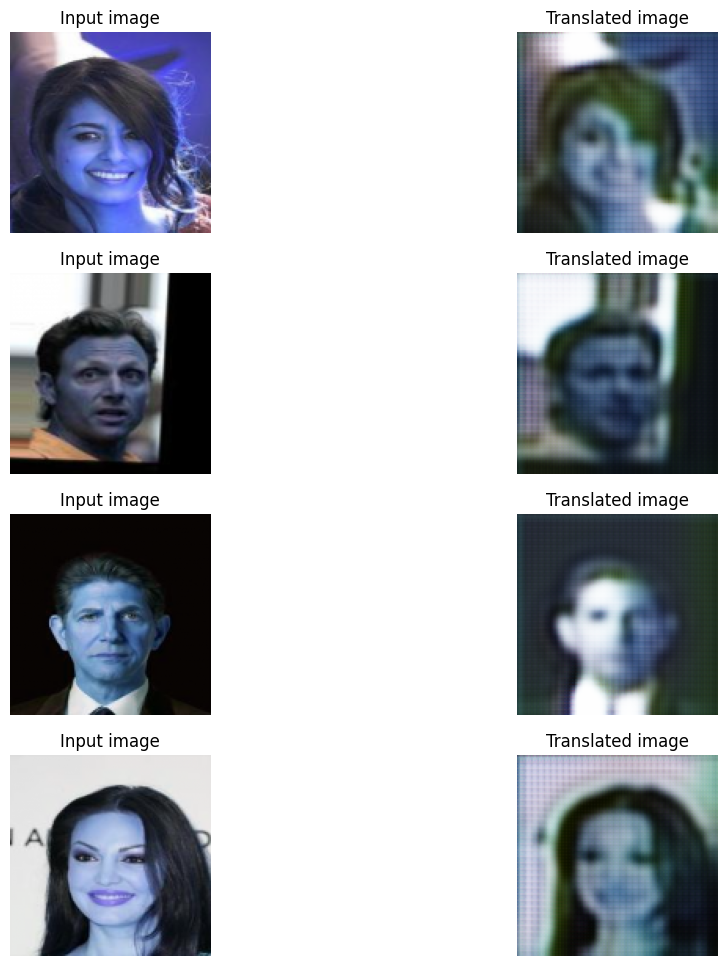

182/182 [==============================] - 58s 319ms/step - G_loss: 0.7106 - F_loss: 0.8016 - D_X_loss: 0.1918 - D_Y_loss: 0.2092
Epoch 8/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6775 - F_loss: 0.7808 - D_X_loss: 0.2069 - D_Y_loss: 0.2448

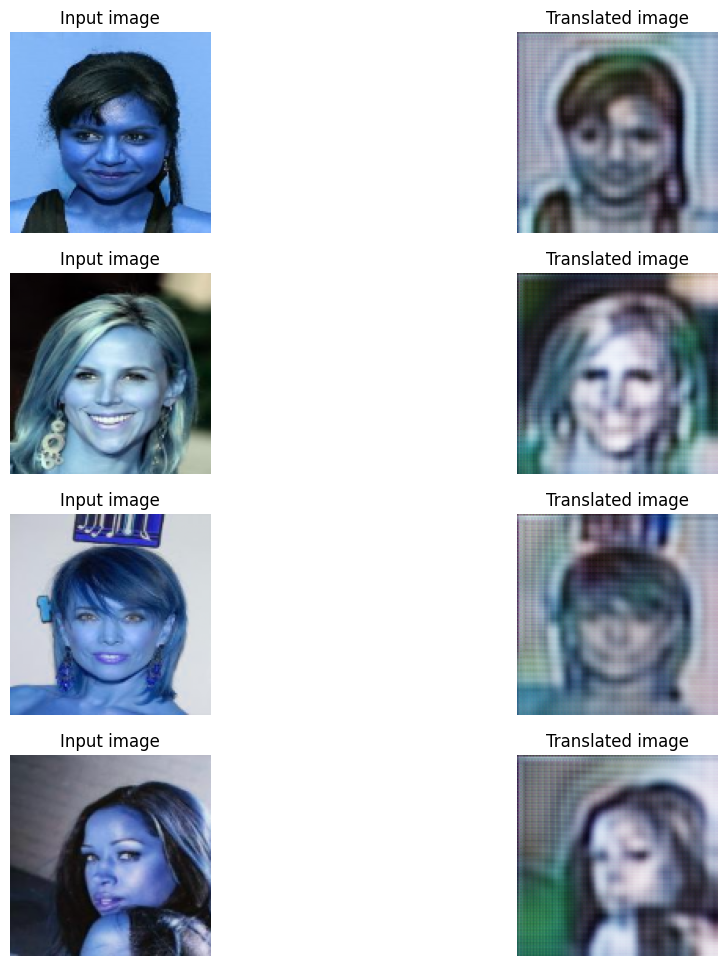

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6771 - F_loss: 0.7803 - D_X_loss: 0.2072 - D_Y_loss: 0.2450
Epoch 9/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6349 - F_loss: 0.7249 - D_X_loss: 0.2394 - D_Y_loss: 0.2456

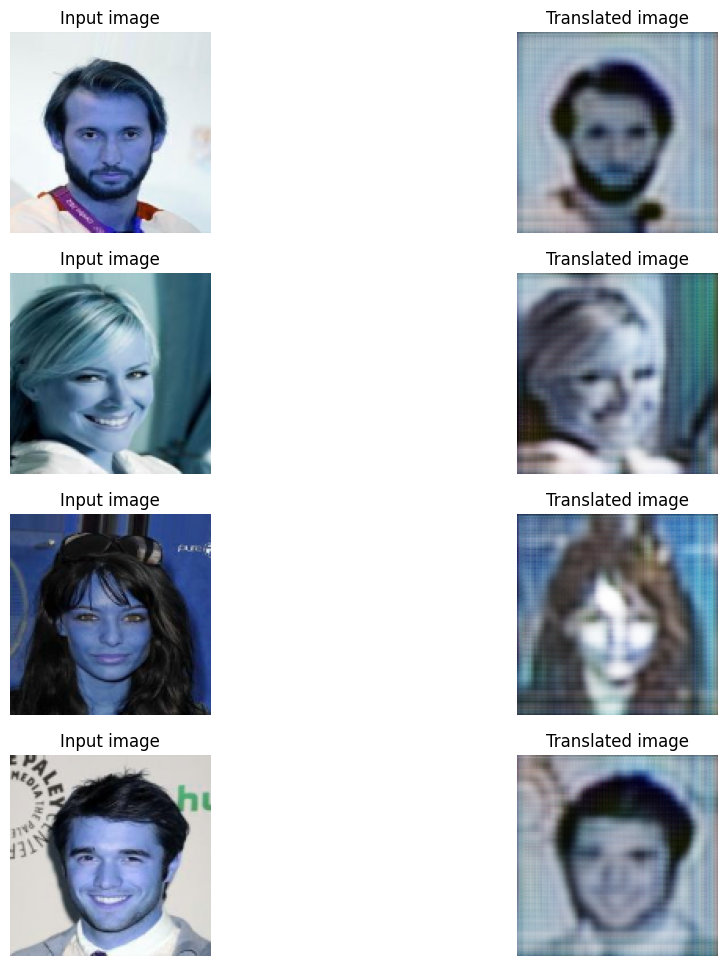

182/182 [==============================] - 59s 326ms/step - G_loss: 0.6347 - F_loss: 0.7252 - D_X_loss: 0.2392 - D_Y_loss: 0.2456
Epoch 10/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6200 - F_loss: 0.7072 - D_X_loss: 0.2245 - D_Y_loss: 0.2389

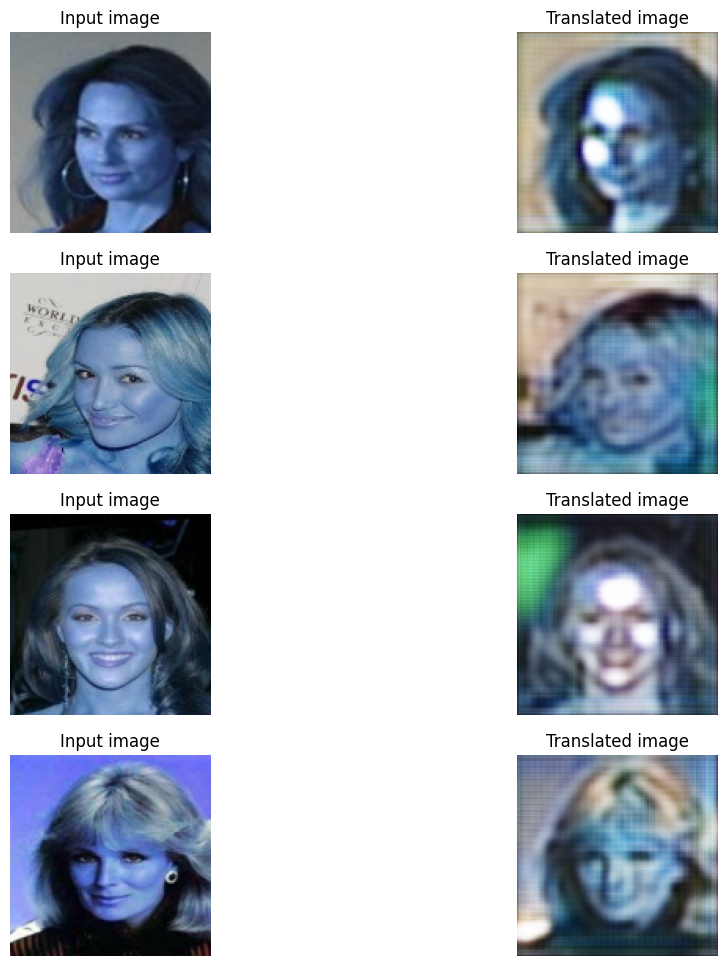

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6200 - F_loss: 0.7077 - D_X_loss: 0.2246 - D_Y_loss: 0.2390
Epoch 11/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6200 - F_loss: 0.6997 - D_X_loss: 0.2236 - D_Y_loss: 0.2333

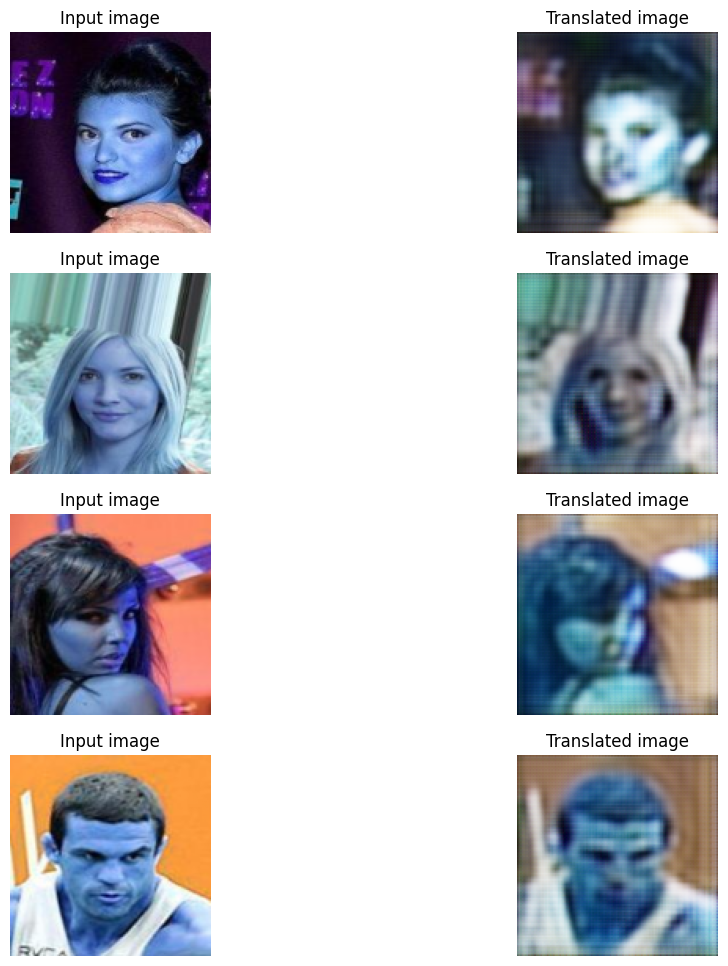

182/182 [==============================] - 58s 320ms/step - G_loss: 0.6202 - F_loss: 0.7008 - D_X_loss: 0.2234 - D_Y_loss: 0.2333
Epoch 12/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6451 - F_loss: 0.6974 - D_X_loss: 0.2258 - D_Y_loss: 0.2217

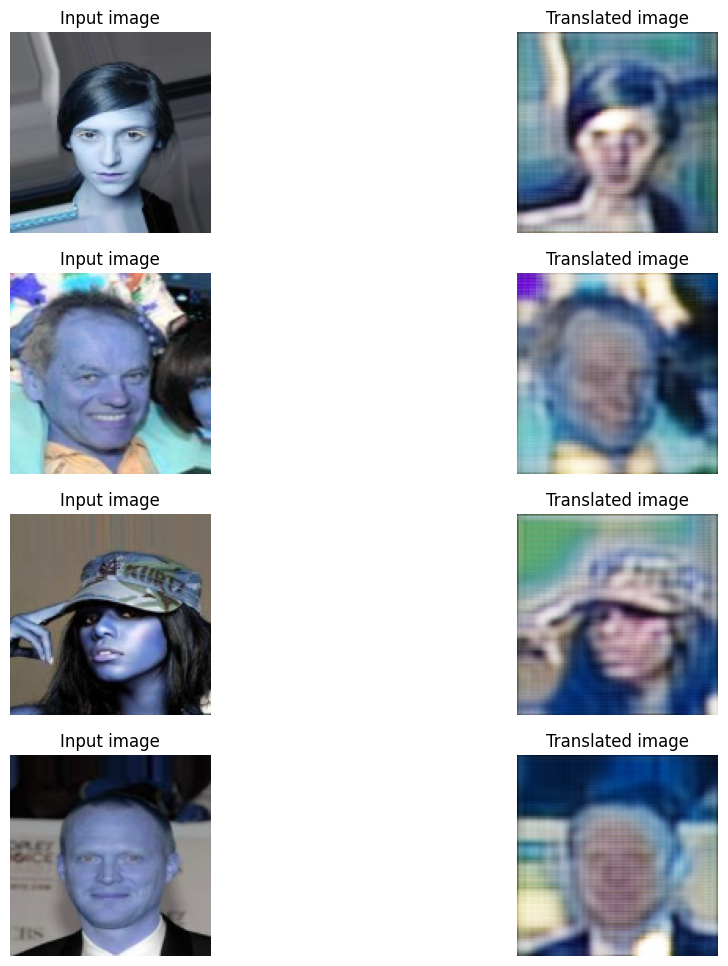

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6449 - F_loss: 0.6978 - D_X_loss: 0.2257 - D_Y_loss: 0.2217
Epoch 13/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6566 - F_loss: 0.7017 - D_X_loss: 0.2269 - D_Y_loss: 0.2261

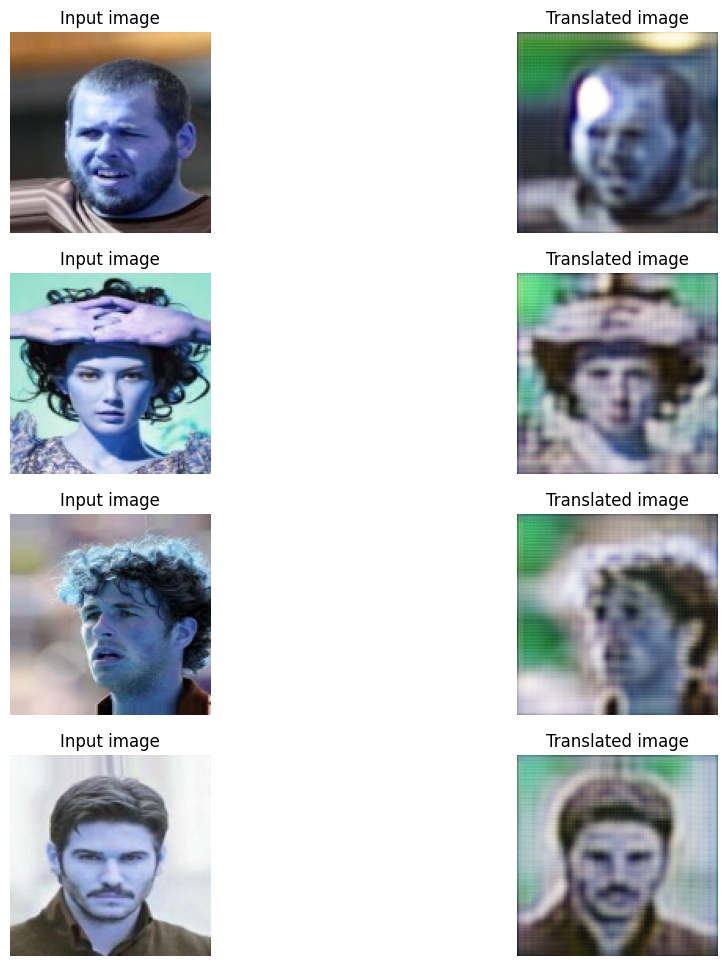

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6562 - F_loss: 0.7023 - D_X_loss: 0.2267 - D_Y_loss: 0.2261
Epoch 14/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6315 - F_loss: 0.6908 - D_X_loss: 0.2258 - D_Y_loss: 0.2363

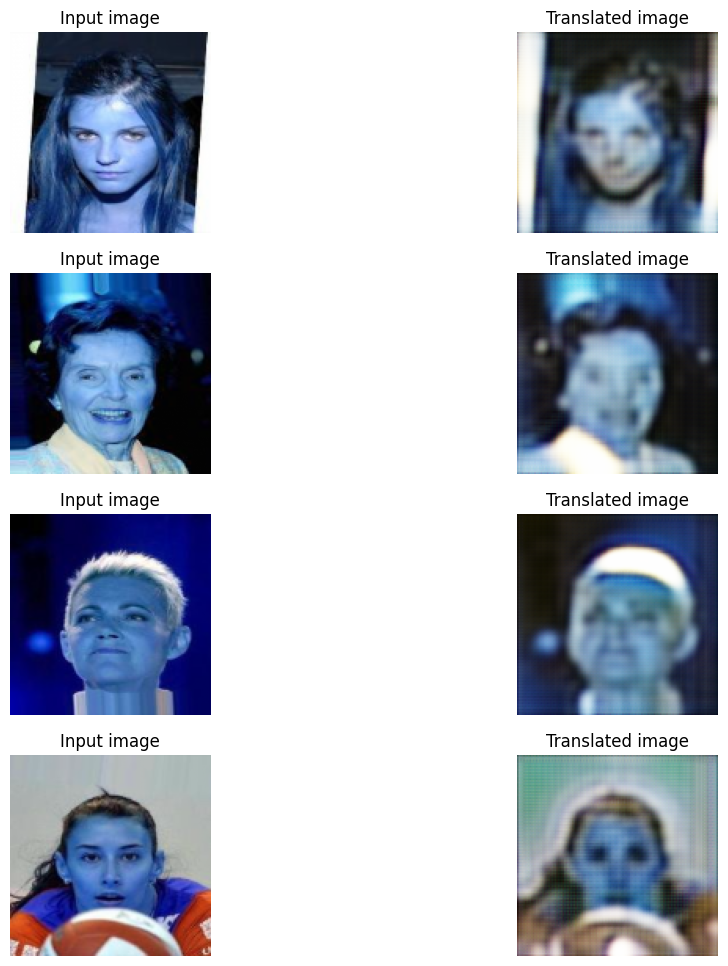

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6308 - F_loss: 0.6910 - D_X_loss: 0.2258 - D_Y_loss: 0.2365
Epoch 15/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6191 - F_loss: 0.6938 - D_X_loss: 0.2253 - D_Y_loss: 0.2390

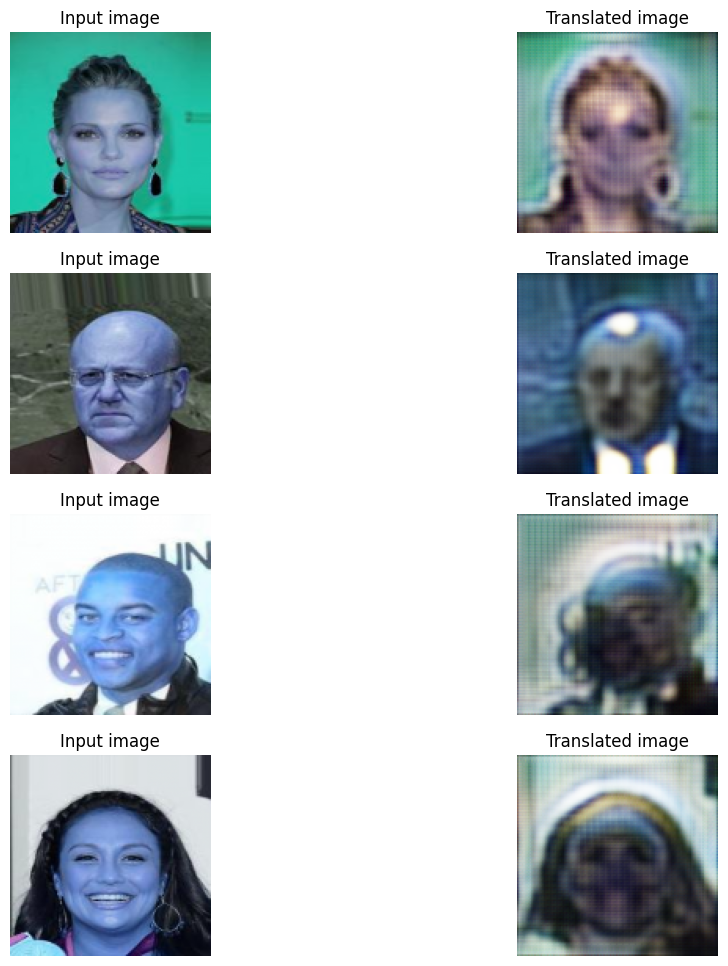

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6191 - F_loss: 0.6941 - D_X_loss: 0.2252 - D_Y_loss: 0.2392
Epoch 16/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6170 - F_loss: 0.6920 - D_X_loss: 0.2245 - D_Y_loss: 0.2394

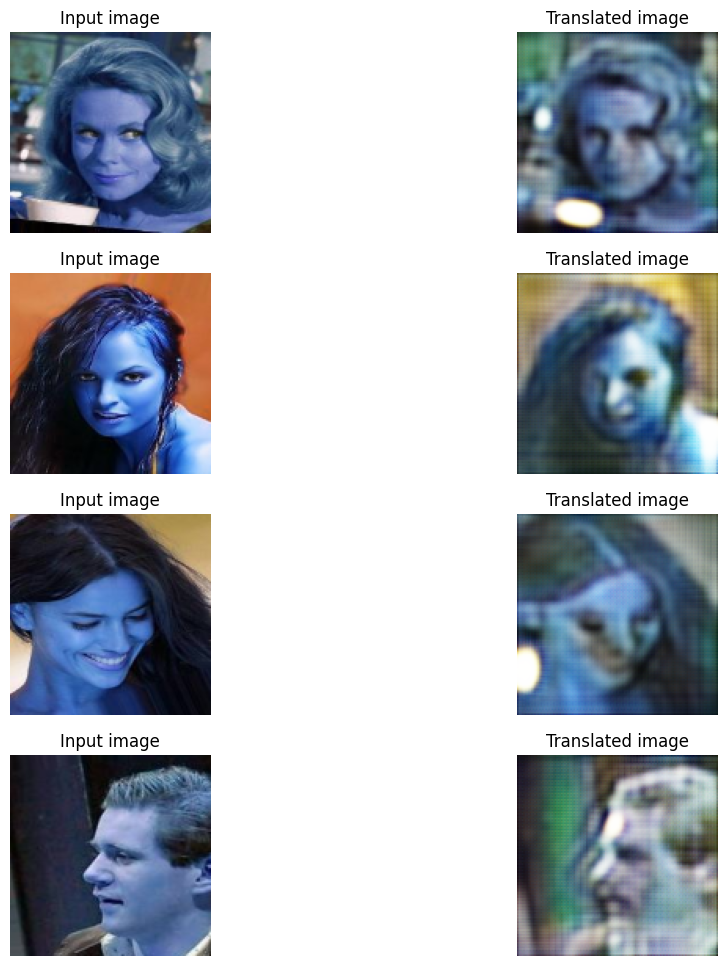

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6170 - F_loss: 0.6919 - D_X_loss: 0.2245 - D_Y_loss: 0.2395
Epoch 17/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6125 - F_loss: 0.6934 - D_X_loss: 0.2276 - D_Y_loss: 0.2386

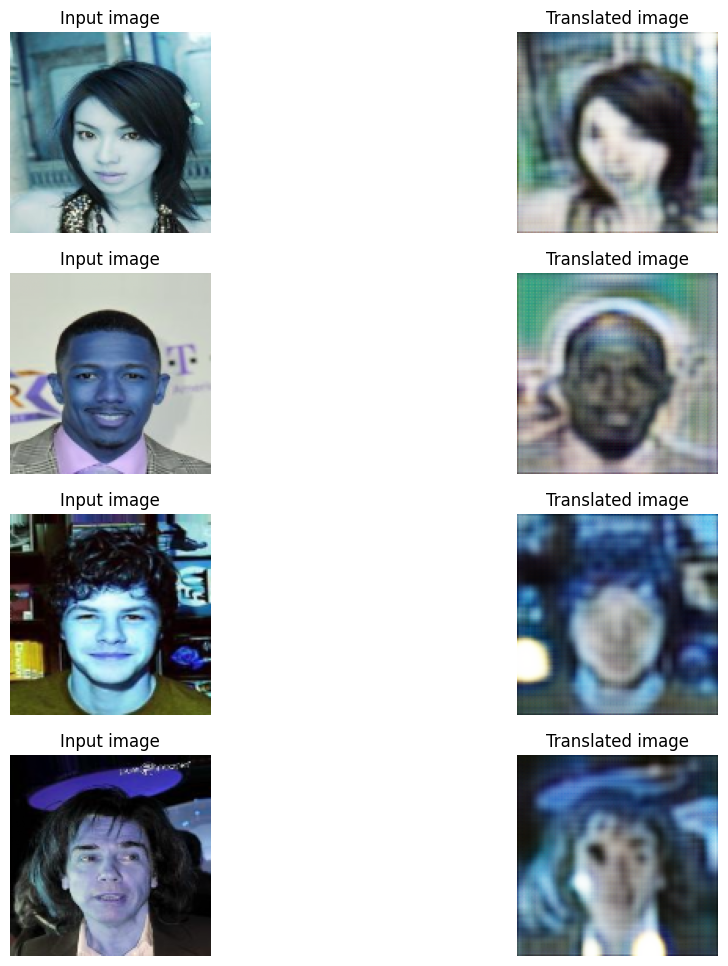

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6122 - F_loss: 0.6938 - D_X_loss: 0.2274 - D_Y_loss: 0.2386
Epoch 18/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6157 - F_loss: 0.6879 - D_X_loss: 0.2281 - D_Y_loss: 0.2395

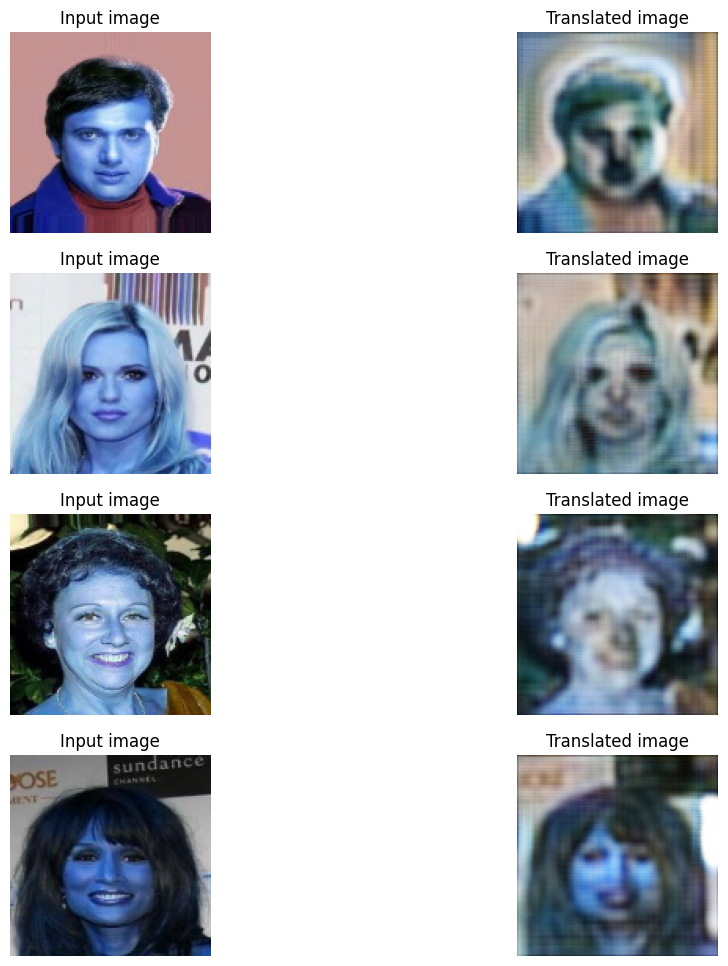

182/182 [==============================] - 58s 320ms/step - G_loss: 0.6152 - F_loss: 0.6884 - D_X_loss: 0.2280 - D_Y_loss: 0.2395
Epoch 19/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6168 - F_loss: 0.6825 - D_X_loss: 0.2291 - D_Y_loss: 0.2385

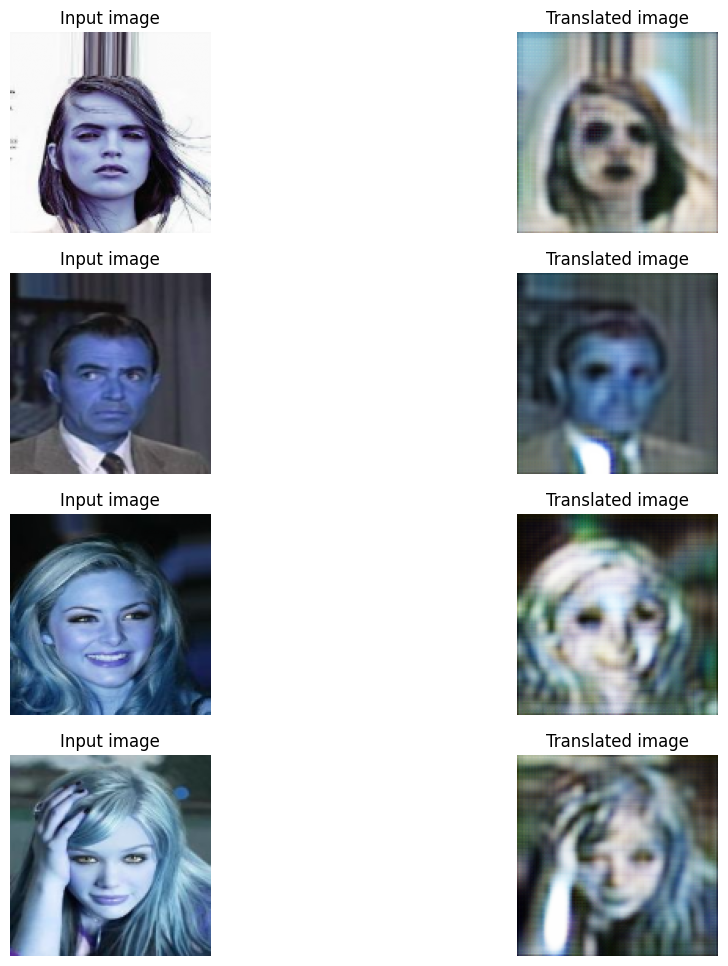

182/182 [==============================] - 58s 320ms/step - G_loss: 0.6165 - F_loss: 0.6825 - D_X_loss: 0.2291 - D_Y_loss: 0.2386
Epoch 20/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6161 - F_loss: 0.6815 - D_X_loss: 0.2291 - D_Y_loss: 0.2388

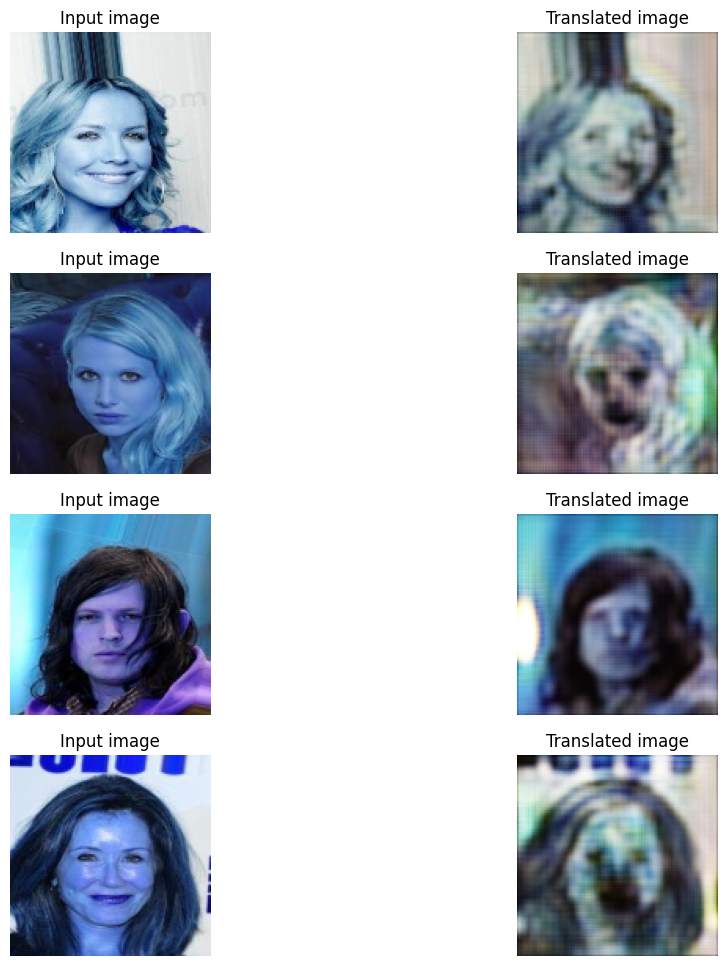

182/182 [==============================] - 58s 319ms/step - G_loss: 0.6154 - F_loss: 0.6817 - D_X_loss: 0.2292 - D_Y_loss: 0.2388
Epoch 21/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6092 - F_loss: 0.6754 - D_X_loss: 0.2304 - D_Y_loss: 0.2375

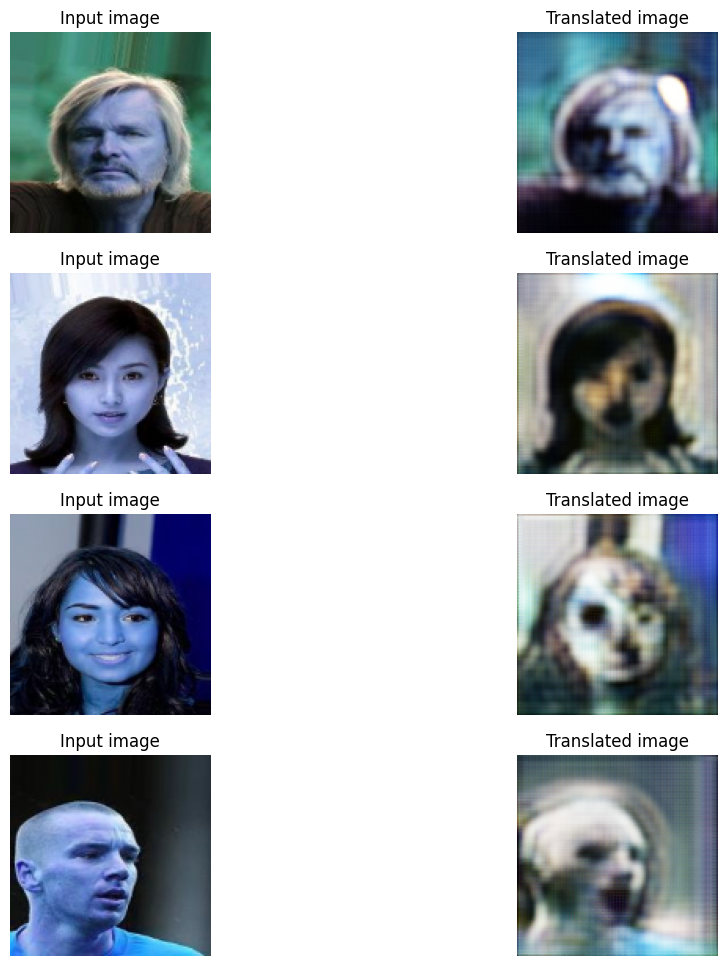

182/182 [==============================] - 58s 318ms/step - G_loss: 0.6086 - F_loss: 0.6751 - D_X_loss: 0.2303 - D_Y_loss: 0.2375
Epoch 22/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6130 - F_loss: 0.6714 - D_X_loss: 0.2322 - D_Y_loss: 0.2389

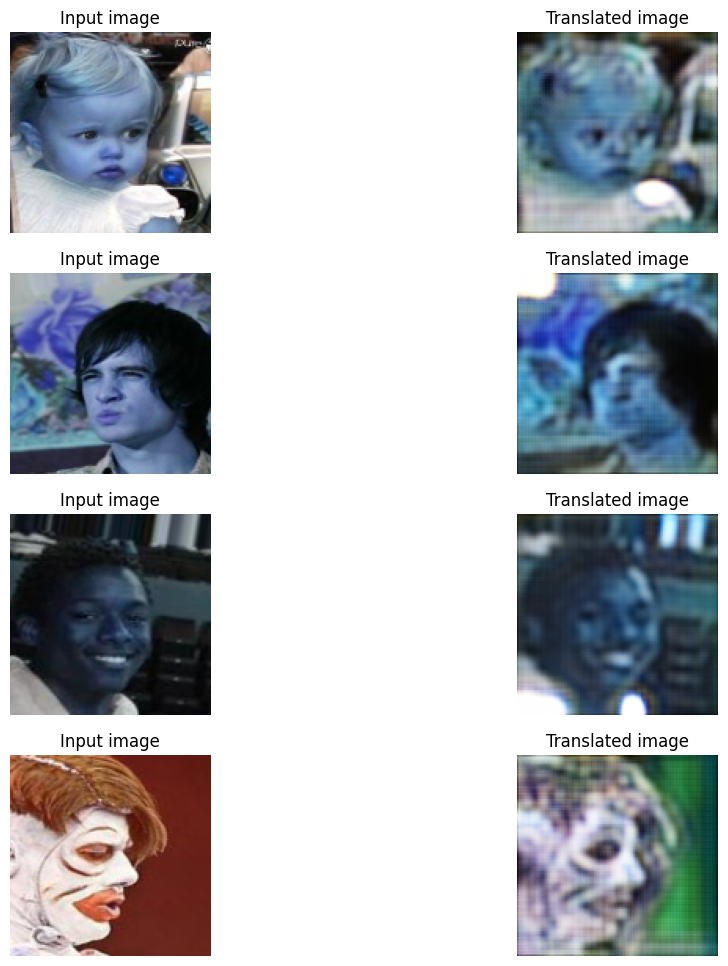

182/182 [==============================] - 58s 318ms/step - G_loss: 0.6131 - F_loss: 0.6713 - D_X_loss: 0.2322 - D_Y_loss: 0.2388
Epoch 23/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6096 - F_loss: 0.6736 - D_X_loss: 0.2324 - D_Y_loss: 0.2379

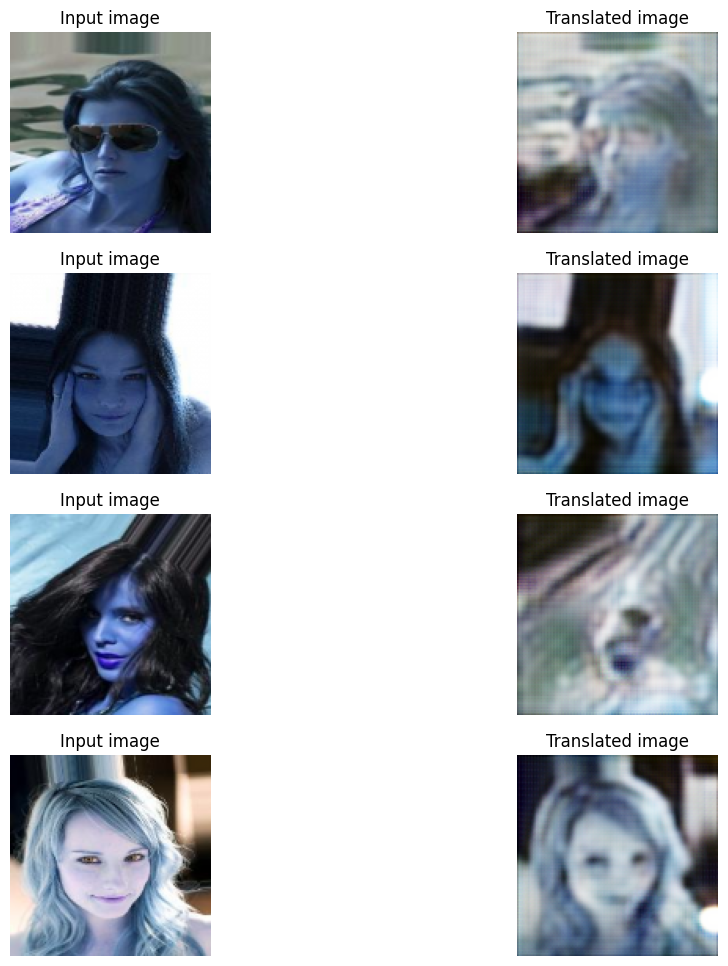

182/182 [==============================] - 58s 318ms/step - G_loss: 0.6098 - F_loss: 0.6732 - D_X_loss: 0.2324 - D_Y_loss: 0.2379
Epoch 24/25
182/182 [==============================] - ETA: 0s - G_loss: 0.6063 - F_loss: 0.6647 - D_X_loss: 0.2387 - D_Y_loss: 0.2374

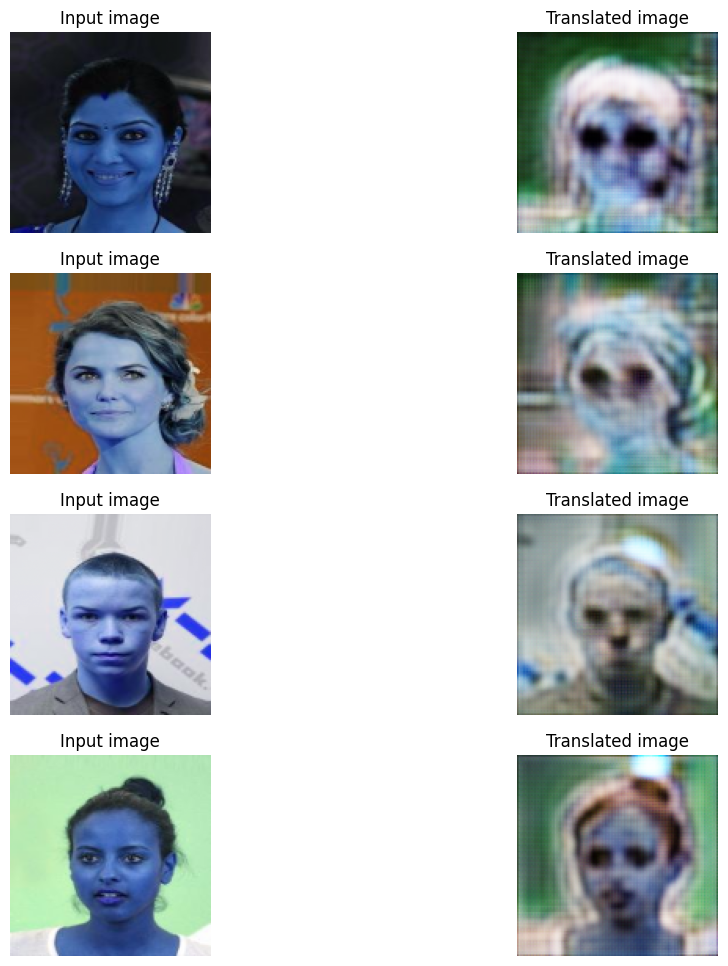

182/182 [==============================] - 59s 326ms/step - G_loss: 0.6068 - F_loss: 0.6645 - D_X_loss: 0.2387 - D_Y_loss: 0.2373
Epoch 25/25
182/182 [==============================] - ETA: 0s - G_loss: 0.5979 - F_loss: 0.6575 - D_X_loss: 0.2337 - D_Y_loss: 0.2387

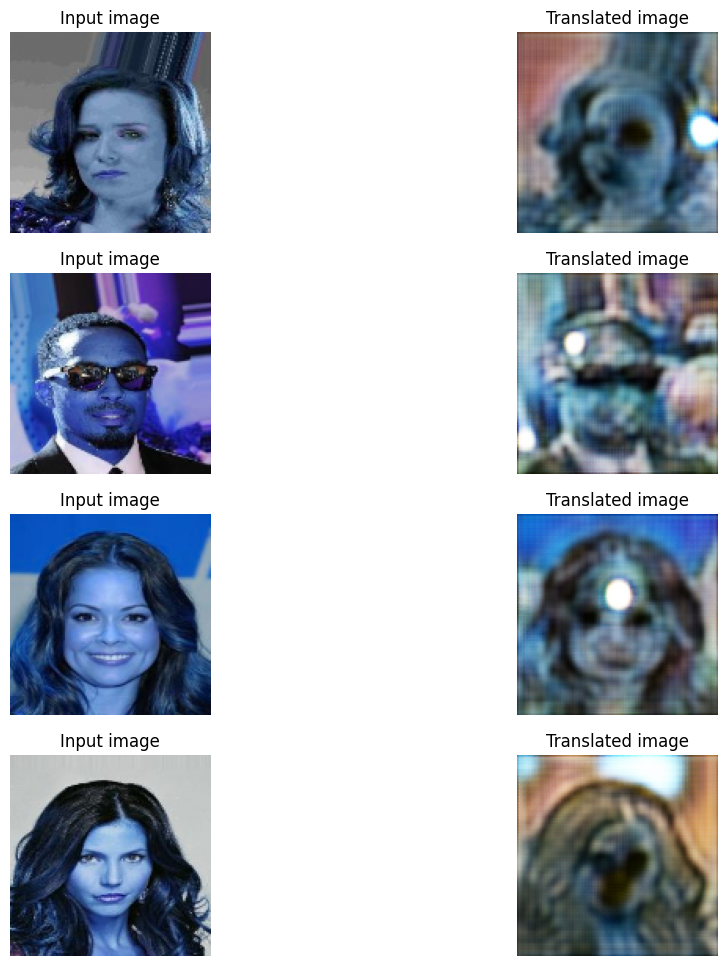

182/182 [==============================] - 58s 318ms/step - G_loss: 0.5978 - F_loss: 0.6574 - D_X_loss: 0.2339 - D_Y_loss: 0.2389


In [ ]:

# Get the generators
gen_G_dog = get_resnet_generator(name="generator_G")
gen_F_dog = get_resnet_generator(name="generator_F")

# Get the discriminators
disc_X_dog = get_discriminator(name="discriminator_X")
disc_Y_dog = get_discriminator(name="discriminator_Y")


# Create cycle gan model
cycle_gan_model_dog = CycleGan(
    generator_G=gen_G_dog, generator_F=gen_F_dog, discriminator_X=disc_X_dog, discriminator_Y=disc_Y_dog
)

# Compile the model
cycle_gan_model_dog.compile(
    gen_G_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)
# Callbacks
plotter = GANMonitor()
checkpoint_filepath = "./model_checkpoints_Human_dog/cyclegan_checkpoints.{epoch:03d}"
model_checkpoint_callback = keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath, save_weights_only=True
)

# Here we will train the model for just one epoch as each epoch takes around
# 7 minutes on a single P100 backed machine.
cycle_gan_model_dog.fit(
    tf.data.Dataset.zip((dataset_faces, dataset_dog)),
    epochs=25,
    callbacks=[plotter, model_checkpoint_callback],
)

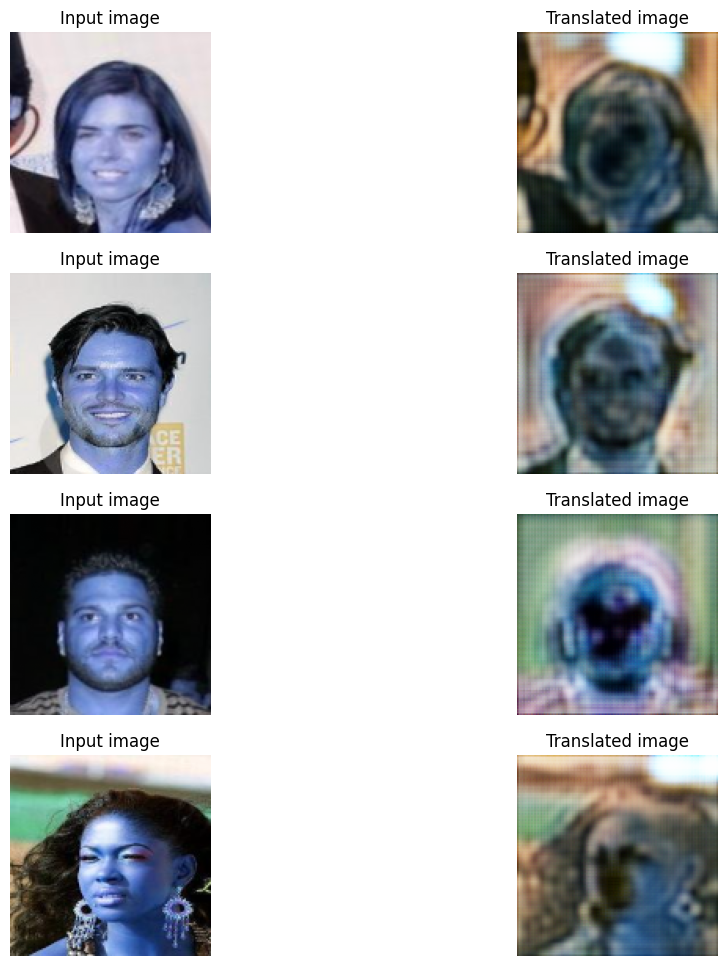

In [ ]:
# # Load the checkpoints
# weight_file = "./saved_checkpoints/cyclegan_checkpoints.090"
# cycle_gan_model.load_weights(weight_file).expect_partial()
# print("Weights loaded successfully")

prediction = cycle_gan_model_dog.gen_G(tf.convert_to_tensor(list(dataset_faces_test.as_numpy_iterator()))).numpy()

_, ax = plt.subplots(4, 2, figsize=(12, 12))
for i, img in enumerate(dataset_faces_test.take(4)):

    ax[i, 0].imshow(img)
    ax[i, 1].imshow(prediction[i])
    ax[i, 0].set_title("Input image")
    ax[i, 1].set_title("Translated image")
    ax[i, 0].axis("off")
    ax[i, 1].axis("off")

plt.show()
plt.close()


## Example Image Conversion


In [14]:

# Get the generators
gen_G_dog = get_resnet_generator(name="generator_G")
gen_F_dog = get_resnet_generator(name="generator_F")

# Get the discriminators
disc_X_dog = get_discriminator(name="discriminator_X")
disc_Y_dog = get_discriminator(name="discriminator_Y")


# Create cycle gan model
cycle_gan_model_dog = CycleGan(
    generator_G=gen_G_dog, generator_F=gen_F_dog, discriminator_X=disc_X_dog, discriminator_Y=disc_Y_dog
)

# Compile the model
cycle_gan_model_dog.compile(
    gen_G_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    gen_F_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    disc_X_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    disc_Y_optimizer=keras.optimizers.legacy.Adam(learning_rate=2e-5, beta_1=0.5),
    gen_loss_fn=generator_loss_fn,
    disc_loss_fn=discriminator_loss_fn,
)

Weights loaded successfully
Weights loaded successfully


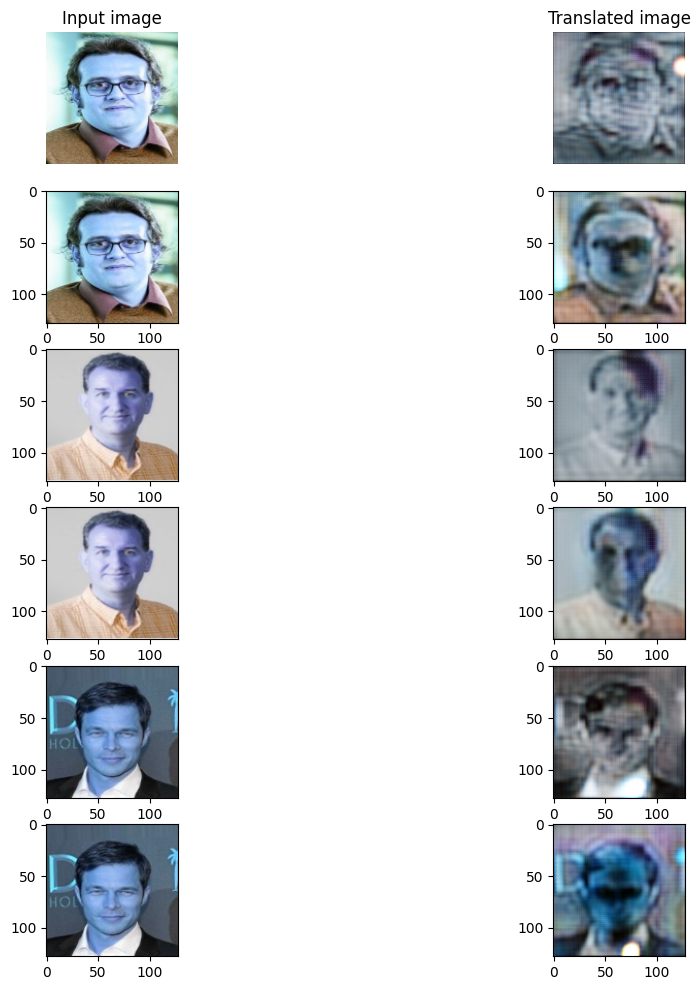

In [42]:
# # Load the checkpoints
weight_file = "./drive/MyDrive/cyclegan_checkpoints.018"
cycle_gan_model_cat.load_weights(weight_file).expect_partial()
print("Weights loaded successfully")


# Load the checkpoints
weight_file = "./drive/MyDrive/cyclegan_checkpoints.025"
cycle_gan_model_dog.load_weights(weight_file).expect_partial()
print("Weights loaded successfully")

Human_image = cv2.imread("/content/image.jpg")
# dog_image = cv2.imread("/content/0AISBYX6WXMH.jpg")
# cat_image = cv2.imread("./2.jpg")
# dog_current_im.reshape(64,64,3)

sample_im_1 = cv2.imread("/content/image _2.jpg")
sample_im_2 = cv2.imread("/content/000033.jpg")
# plt.imshow(Human_image)

Human_image = resize(Human_image, (128,128,3), mode = "constant",  anti_aliasing=True)
# dog_image = resize(dog_image, (128,128,3), mode = "constant",  anti_aliasing=True)
# cat_image = resize(cat_image, (128,128,3), mode = "constant",  anti_aliasing=True)
sample_im_1 = resize(sample_im_1, (128,128,3), mode = "constant",  anti_aliasing=True)
sample_im_2 = resize(sample_im_2, (128,128,3), mode = "constant",  anti_aliasing=True)

# cat_list = np.array([cat_image])
# dog_list = np.array([dog_image])
human_list = np.array([Human_image])
sample_1_list = np.array([sample_im_1])
sample_2_list = np.array([sample_im_2])


# cat_list = normalize_img(cat_list)
# dog_list = normalize_img(dog_list)
human_list = normalize_img(human_list)
sample_1_list = normalize_img(sample_1_list)
sample_2_list = normalize_img(sample_2_list)


# dataset_cat_check = tf.data.Dataset.from_tensor_slices(cat_list)
# dataset_cat_check = dataset_cat_check.shuffle(buffer_size=1)
# dataset_cat_check = dataset_cat_check.batch(1)
dataset_sample_1 = tf.data.Dataset.from_tensor_slices(sample_1_list)
dataset_sample_1 = dataset_sample_1.shuffle(buffer_size=1)
dataset_sample_1 = dataset_sample_1.batch(1)



dataset_sample_2 = tf.data.Dataset.from_tensor_slices(sample_2_list)
dataset_sample_2 = dataset_sample_2.shuffle(buffer_size=1)
dataset_sample_2 = dataset_sample_2.batch(1)

# dataset_dog_check = tf.data.Dataset.from_tensor_slices(dog_list)
# dataset_dog_check = dataset_dog_check.shuffle(buffer_size=1)
# dataset_dog_check = dataset_dog_check.batch(1)

dataset_human_check = tf.data.Dataset.from_tensor_slices(human_list)
dataset_human_check = dataset_human_check.shuffle(buffer_size=1)
dataset_human_check = dataset_human_check.batch(1)

# cat_img_val = tf.convert_to_tensor(list(dataset_cat_check.take(1)))
# dog_img_val = tf.convert_to_tensor(list(dataset_dog_check.take(1)))
human_img_val = tf.convert_to_tensor(list(dataset_human_check.take(1)))
sample_1_val = tf.convert_to_tensor(list(dataset_sample_1.take(1)))
sample_2_val = tf.convert_to_tensor(list(dataset_sample_2.take(1)))

# tf.data.Dataset.from_tensor_slices(tf.expand_dims(img, axis=0)).batch(batch_size)
prediction_Human_cat = cycle_gan_model_cat.gen_G(human_img_val[0]).numpy()
# prediction_cat_Human = cycle_gan_model_cat.gen_F(cat_img_val[0]).numpy()
prediction_Human_dog = cycle_gan_model_dog.gen_G(human_img_val[0]).numpy()
# prediction_dog_Human = cycle_gan_model_dog.gen_F(dog_img_val[0]).numpy()
prediction_sample_1_cat = cycle_gan_model_cat.gen_G(sample_1_val[0]).numpy()
prediction_sample_1_dog = cycle_gan_model_dog.gen_G(sample_1_val[0]).numpy()
prediction_sample_2_cat = cycle_gan_model_cat.gen_G(sample_2_val[0]).numpy()
prediction_sample_2_dog = cycle_gan_model_dog.gen_G(sample_2_val[0]).numpy()


_, ax = plt.subplots(6, 2, figsize=(12, 12))

ax[0, 0].imshow(Human_image)
ax[0, 1].imshow(prediction_Human_cat[0])
ax[0, 0].set_title("Input image")
ax[0, 1].set_title("Translated image")
ax[0, 0].axis("off")
ax[0, 1].axis("off")

ax[1, 0].imshow(Human_image)
ax[1, 1].imshow(prediction_Human_dog[0])
ax[0, 0].set_title("Input image")
ax[0, 1].set_title("Translated image")
ax[0, 0].axis("off")
ax[0, 1].axis("off")

ax[2, 0].imshow(sample_im_1)
ax[2, 1].imshow(prediction_sample_1_cat[0])
ax[0, 0].set_title("Input image")
ax[0, 1].set_title("Translated image")
ax[0, 0].axis("off")
ax[0, 1].axis("off")

ax[3, 0].imshow(sample_im_1)
ax[3, 1].imshow(prediction_sample_1_dog[0])
ax[0, 0].set_title("Input image")
ax[0, 1].set_title("Translated image")
ax[0, 0].axis("off")
ax[0, 1].axis("off")

ax[4, 0].imshow(sample_im_2)
ax[4, 1].imshow(prediction_sample_2_cat[0])
ax[0, 0].set_title("Input image")
ax[0, 1].set_title("Translated image")
ax[0, 0].axis("off")
ax[0, 1].axis("off")

ax[5, 0].imshow(sample_im_2)
ax[5, 1].imshow(prediction_sample_2_dog[0])
ax[0, 0].set_title("Input image")
ax[0, 1].set_title("Translated image")
ax[0, 0].axis("off")
ax[0, 1].axis("off")

plt.show()
plt.close()
